# Import packages

In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>")) #Set scaling for the jupyter notebook cell width - make them bigger

/tmp/ipykernel_1156/3983057131.py:1: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display, HTML


In [2]:
#General packages
from IPython.display import clear_output #import of a single funtcion
import sys #system related packages
import os #better path and file handling
import pickle #saving and loading objects

#Tables, numbers etc
import pandas as pd #tables
import numpy as np #arrays
import scipy #sciency functions
from sklearn import mixture #For gaussian mixture model

#Plotting packages
import matplotlib.pyplot as plt #Main plotting
from matplotlib.ticker import MaxNLocator
from matplotlib.lines import Line2D
import seaborn as sbn #nicer plots

#RNA-seq analysis
import scanpy as sc #Main package for scRNA-seq analysis
import scanpy.external as sce #some more functions for scanpy
import bbknn #batch correction


root = '/mnt/g' if 'mnt' in os.getcwd() else 'G:' #root path depending on which environment I use

#Import some custom helper functions for plotting
path_skin_scripts = '/mnt/g/My Drive/Python/Projects'.format(root)
sys.path.append(path_skin_scripts)
from Skin_scripts import *

# HMU

In [ ]:
sample = 'HMW'

In [9]:
path = '{}/My Drive/MKA/Papers/Greco/Sara and Nur/Loom files'.format(root)
filename = f'{sample}_validation.loom'

In [10]:
adata = sc.read_loom(os.path.join(path, filename), spec_version = 'old', validate = False)

In [11]:
adata.obs['seurat_clusters'] = adata.obs['seurat_clusters'].astype(str)
adata.var['ribo'] = adata.var_names.str.startswith('Rps') | adata.var_names.str.startswith('Rpl')
adata.var['mito'] = adata.var_names.str.startswith('mt')
adata.var['hemo'] = adata.var_names.str.startswith('Hba') | adata.var_names.str.startswith('Hbb')

In [12]:
adata

AnnData object with n_obs × n_vars = 30951 × 18634
    obs: 'Immune21', 'Infundibulum1', 'RBC1', 'RNA_snn_res.0.1', 'integrated_snn_res.0.1', 'nCount_RNA', 'nFeature_RNA', 'orig.ident', 'percent.mt', 'seurat_clusters'
    var: 'ribo', 'mito', 'hemo'
    layers: 'counts'

In [13]:
sc.pp.calculate_qc_metrics(adata, inplace = True, qc_vars = ['ribo','mito','hemo'])

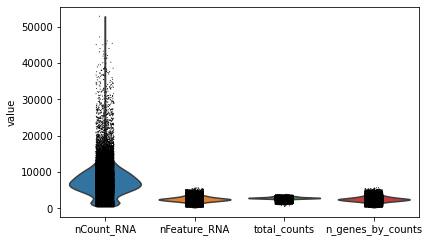

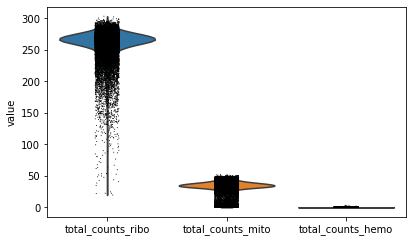

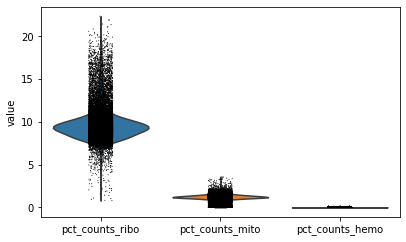

In [14]:
sc.pl.violin(adata, keys = ['nCount_RNA','nFeature_RNA', 'total_counts', 'n_genes_by_counts'])
sc.pl.violin(adata, keys = ['total_counts_ribo','total_counts_mito', 'total_counts_hemo'])
sc.pl.violin(adata, keys = ['pct_counts_ribo','pct_counts_mito', 'pct_counts_hemo'])

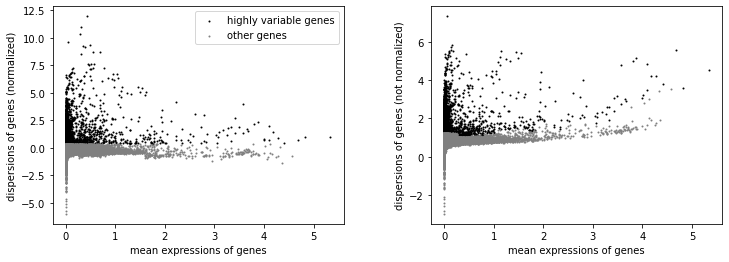

In [15]:
sc.pp.highly_variable_genes(adata, n_top_genes = 4000)
sc.pl.highly_variable_genes(adata)

In [16]:
adata.raw = adata

In [17]:
sc.pp.filter_genes(adata, min_cells=5)
sc.pp.filter_genes(adata, min_counts=10)

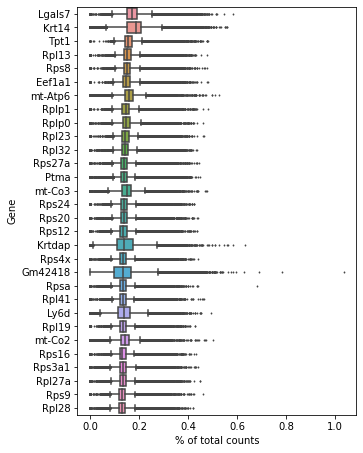

In [19]:
sc.pl.highest_expr_genes(adata)

In [20]:
sc.pp.scale(adata)

In [34]:
#sc.pp.pca(adata)
#sce.pp.harmony_integrate(adata, key = 'orig.ident')
sc.pp.neighbors(adata, use_rep='X_pca_harmony')
#bbknn.bbknn(adata, batch_key='orig.ident')
sc.tl.umap(adata, spread = 1)

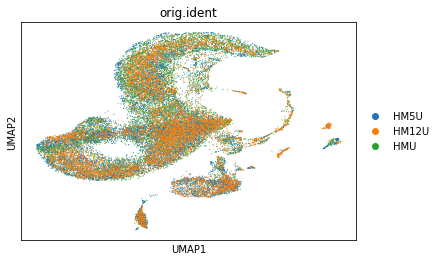

In [35]:
sc.pl.umap(adata, color = 'orig.ident')

In [36]:
sc.tl.leiden(adata, resolution = 0.3)

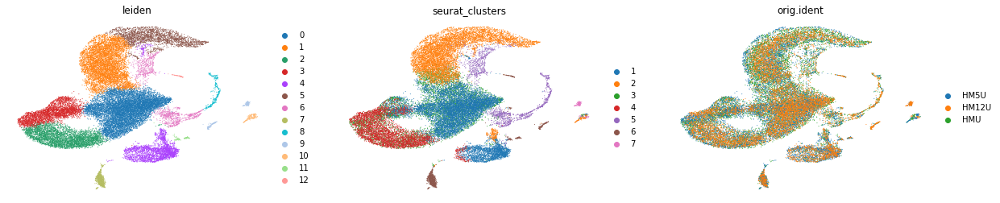

In [38]:
sc.pl.umap(adata, color = ['leiden', 'seurat_clusters', 'orig.ident'], frameon = False)

Output from the previous version (some package versions changed)

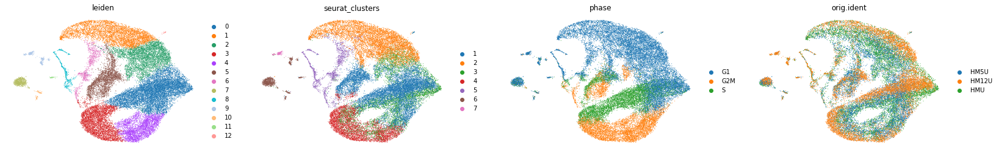

In [20]:
sc.pl.umap(adata, color = ['leiden', 'seurat_clusters', 'phase', 'orig.ident'], frameon = False)

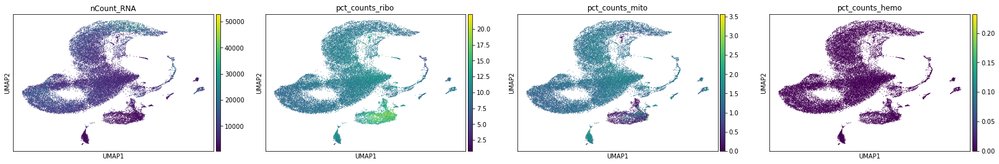

In [40]:
sc.pl.umap(adata, color = ['nCount_RNA', 'pct_counts_ribo','pct_counts_mito', 'pct_counts_hemo'])

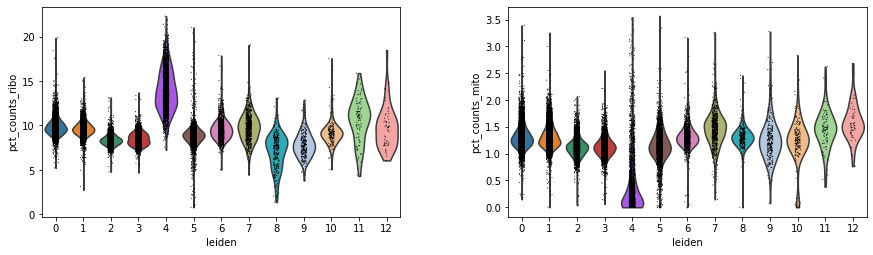

In [41]:
sc.pl.violin(adata, keys = ['pct_counts_ribo', 'pct_counts_mito'], groupby='leiden')

In [23]:
sum(adata.obs['leiden']=='5')

2723

In [24]:
sum(adata.obs['leiden']!='5')

28228

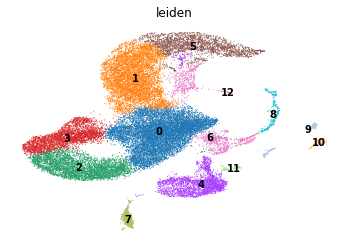

In [42]:
#sc.tl.leiden(adata, resolution = 0.5)
#sc.pl.umap(adata, color = ['leiden'])
sc.pl.umap(adata, color = ['leiden'], legend_loc='on data', frameon = False)

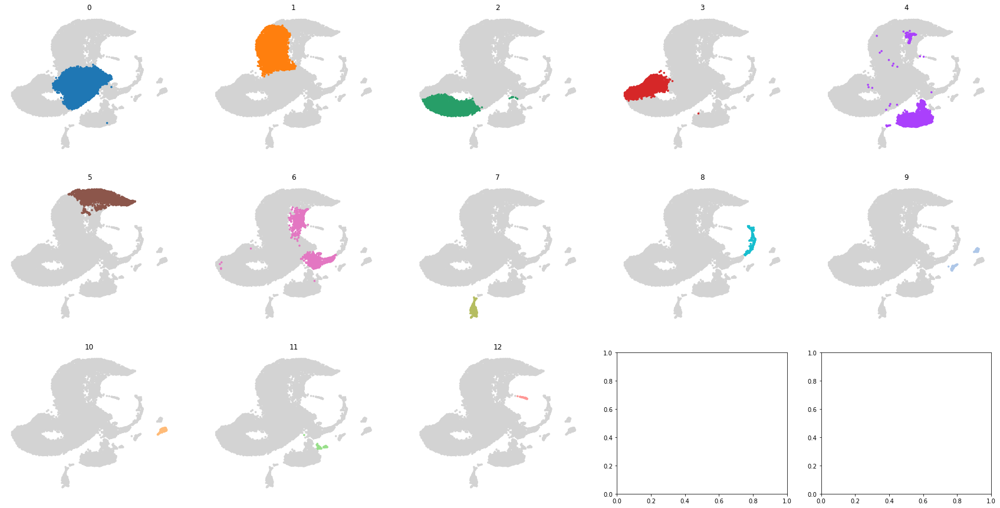

In [47]:
groups = adata.obs['leiden'].unique()
ncols = 5
fig, axes = initialize_subplots(len(groups), ncols = ncols, figsize_multiplier=(6,5))

for ix, g in enumerate(sorted(groups, key = lambda x: int(x))):
    ax = get_ax(axes, ix, ncols)
    sc.pl.umap(adata, color = 'leiden', ax = ax, show = False, frameon = False, groups = [g], legend_loc = 'on_data', title = g, s = 50)
clear_output()

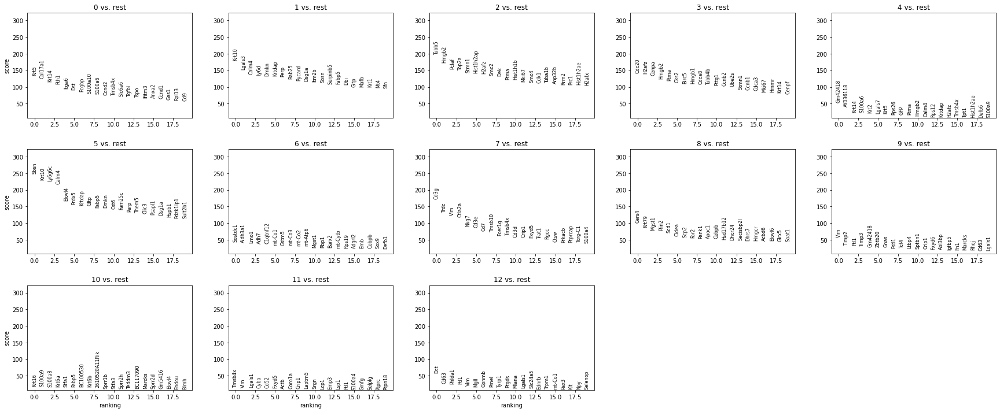

,0,1,2,3,4,5,6,7,8,9,10,11,12
0,Krt5,Krt10,Tubb5,Cdc20,Gm42418,Sbsn,Sostdc1,Cd3g,Cers4,Vim,Krt16,Tmsb4x,Dct
1,Col17a1,Lgals3,Hmgb2,H2afz,AY036118,Krt10,Aldh3a1,Trdc,Krt79,Timp2,S100a9,Vim,Cd63
2,Krt14,Calm4,Pclaf,Cenpa,Krt14,Ly6g6c,Lmo1,Vim,Mgst1,Ftl1,S100a8,Lgals1,Phlda1
3,Fth1,Ly6d,Top2a,Hmgb2,S100a6,Calm4,Adh7,Ctla2a,Plin2,Timp3,Krt6a,Cyba,Ftl1
4,Itga6,Dmkn,Stmn1,Ptma,Krt2,Elovl4,C1qtnf12,Nkg7,Scd1,Gm42418,Stfa1,Cd52,Vim
5,Dst,Krtdap,Hist1h2ap,Cks2,Lgals7,Prdx5,mt-Co1,Cd3e,Cidea,Zbtb20,Fabp5,Fxyd5,Mgll
6,Fcgbp,Perp,H2afz,Birc5,Krt5,Krtdap,Gstm5,Cd7,Scp2,Gnas,BC100530,Actb,Gpnmb
7,S100a10,Rab25,Smc2,Hmgb1,Rps26,Gltp,mt-Co3,Tmsb10,Far2,Fstl1,Krt6b,Coro1a,Pmel
8,S100a6,Pycard,Dek,Cdca8,GFP,Fabp5,mt-Co2,Fcer1g,Pank1,Tcf4,2610528A11Rik,Crip1,Tyrp1
9,Ccnd2,Dsg1a,Ptma,Tubb4b,Ptma,Dmkn,mt-Atp6,Tmsb4x,Apoc1,Ltbp4,Sprr1b,Laptm5,Ptgds


In [48]:
sc.tl.rank_genes_groups(adata, groupby = 'leiden')
sc.pl.rank_genes_groups(adata, ncols = 5)
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(20)

/home/karlan/miniconda3/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1227: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


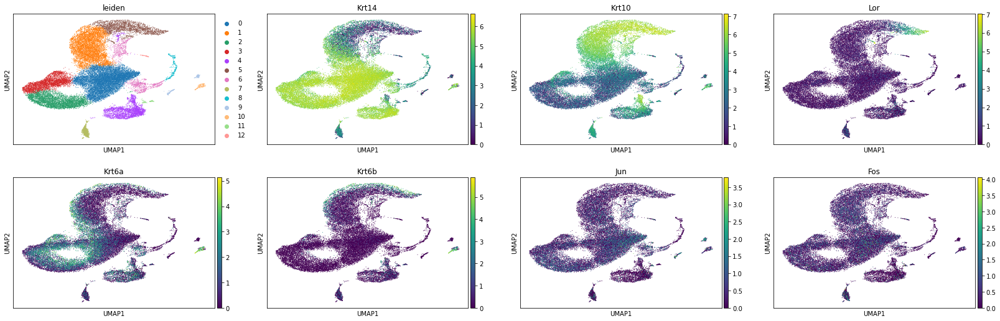

In [49]:
sc.pl.umap(adata, color = ['leiden', 'Krt14','Krt10','Lor', 'Krt6a','Krt6b','Jun','Fos'], groups = groups, ncols = 4)

## Remove KCs

In [53]:
KC_groups = ['0','1','2','3','4','5','6','8']

In [59]:
adata = adata[~adata.obs['leiden'].isin(KC_groups)].copy()

In [60]:
sc.pp.pca(adata)
sce.pp.harmony_integrate(adata, key = 'orig.ident')
sc.pp.neighbors(adata, use_rep='X_pca_harmony')
#bbknn.bbknn(adata, batch_key='orig.ident')
sc.tl.umap(adata, spread = 1)

2022-05-23 22:18:33,199 - harmonypy - INFO - Iteration 1 of 10
2022-05-23 22:18:33,550 - harmonypy - INFO - Iteration 2 of 10
2022-05-23 22:18:33,904 - harmonypy - INFO - Iteration 3 of 10
2022-05-23 22:18:34,109 - harmonypy - INFO - Iteration 4 of 10
2022-05-23 22:18:34,241 - harmonypy - INFO - Iteration 5 of 10
2022-05-23 22:18:34,393 - harmonypy - INFO - Iteration 6 of 10
2022-05-23 22:18:34,519 - harmonypy - INFO - Converged after 6 iterations


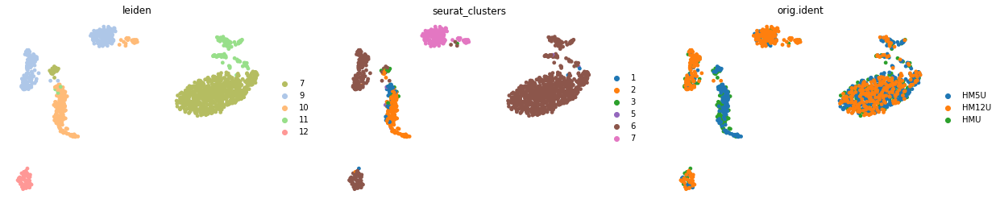

In [61]:
sc.pl.umap(adata, color = ['leiden', 'seurat_clusters', 'orig.ident'], frameon = False)

In [63]:
sc.tl.leiden(adata)

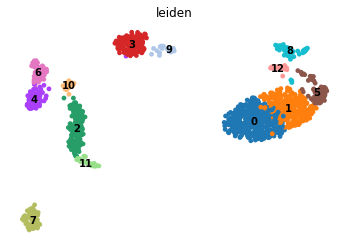

In [64]:
sc.pl.umap(adata, color = ['leiden'], legend_loc='on data', frameon = False)

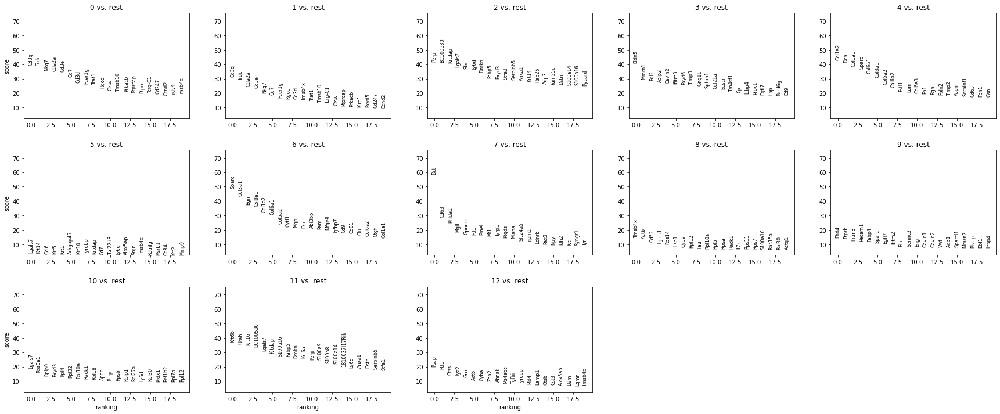

,0,1,2,3,4,5,6,7,8,9,10,11,12
0,Cd3g,Cd3g,Perp,Cldn5,Col1a2,Lgals7,Sparc,Dct,Tmsb4x,Ehd4,Lgals7,Krt6b,Psap
1,Trdc,Trdc,BC100530,Mmrn1,Dcn,Krt14,Col3a1,Cd63,Actb,Ptprb,Rps3a1,Urah,Ftl1
2,Nkg7,Ctla2a,Krtdap,Fgl2,Col1a1,Ccl6,Bgn,Phlda1,Cd52,Ifitm3,Rplp0,Krt16,Ctss
3,Ctla2a,Cd3e,Lgals7,Aplp2,Sparc,Krt5,Col8a1,Mgll,Lgals1,Pecam1,Fxyd3,BC100530,Lyz2
4,Cd3e,Nkg7,Sfn,Cavin2,Col6a1,Krt1,Col1a2,Gpnmb,Rps14,Fabp4,Rpl4,Lgals7,Grn
5,Cd7,Cd7,Ly6d,Ifitm3,Col3a1,Arhgap45,Col6a1,Ftl1,Lsp1,Sparc,Rpl32,Krtdap,Actb
6,Cd3d,Fcer1g,Dmkn,Fxyd6,Col5a2,Krt10,Col5a2,Pmel,Cyba,Egfl7,Rpl10a,S100a16,Cyba
7,Fcer1g,Rgcc,Fabp5,Timp3,Col6a2,Tyrobp,Cytl1,Mt1,Rpl12,Ifitm2,Rack1,Fabp5,Zeb2
8,Trat1,Cd3d,Fxyd3,Gng11,Fstl1,Krtdap,Mgp,Tyrp1,Fau,Eln,Rpl18,Dmkn,Ahnak
9,Rgcc,Tmsb4x,Stfa3,Sptbn1,Lum,Cd7,Dcn,Ptgds,Rpl18a,Serinc3,Apoe,Krt6a,Ms4a6c


In [65]:
sc.tl.rank_genes_groups(adata, groupby = 'leiden')
sc.pl.rank_genes_groups(adata, ncols = 5)
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(20)

In [76]:
leiden_named = {'0': 'T-cells 1',
                '1': 'T-cells 2',
                '2': 'KC+IMM 1',
                '3': 'Lymph',
                '4': 'FIB 1',
                '5': 'KC+IMM 2 (T)',
                '6': 'FIB 2',
                '7': 'MEL',
                '8': 'IMM (MC, LC, DC)',
                '9': 'EC',
                '10': '???',
                '11': 'KC+IMM 3',
                '12': 'IMM (MC?)',
                }

adata.obs['leiden_named'] = adata.obs['leiden'].apply(lambda x: leiden_named[x])

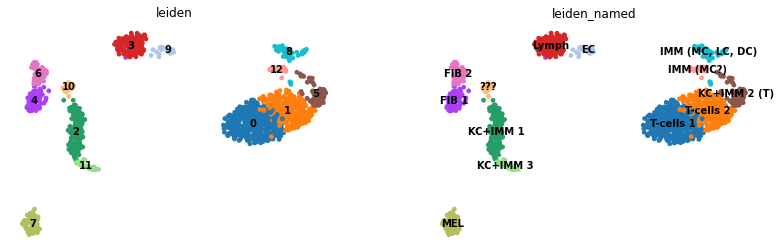

In [77]:
sc.pl.umap(adata, color = ['leiden', 'leiden_named'], legend_loc='on data', frameon = False)

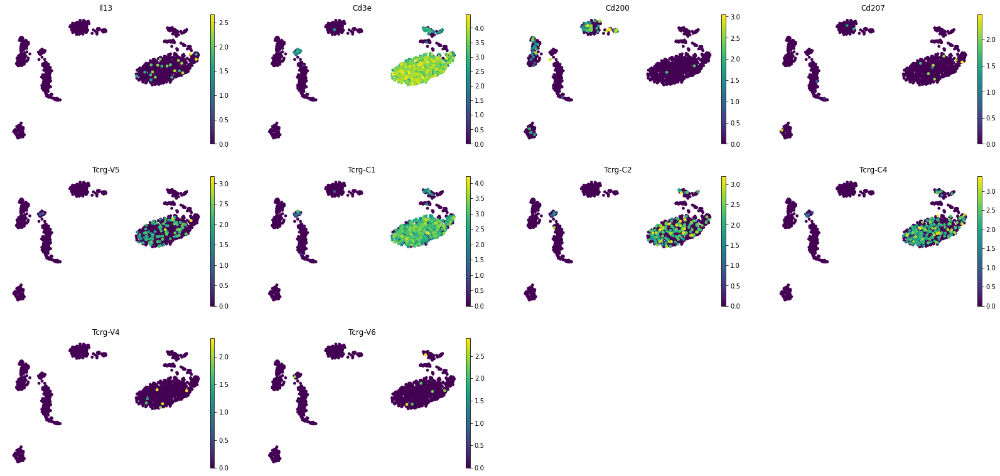

In [85]:
sc.pl.umap(adata, color = ['Il13', 'Cd3e', 'Cd200', 'Cd207', 'Tcrg-V5', 'Tcrg-C1', 'Tcrg-C2', 'Tcrg-C4', 'Tcrg-V4', 'Tcrg-V6'], legend_loc='on data', frameon = False)

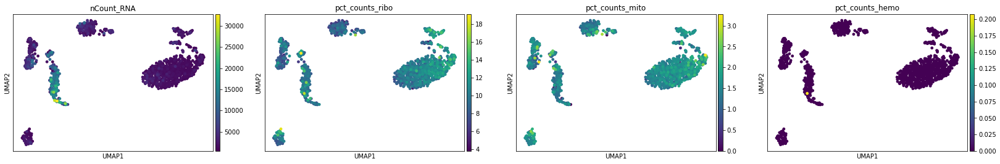

In [78]:
sc.pl.umap(adata, color = ['nCount_RNA', 'pct_counts_ribo','pct_counts_mito', 'pct_counts_hemo'])

## Save cells

In [ ]:
path = '{}/My Drive/MKA/Papers/Greco/Sara and Nur/Loom files'.format(root)
filename = f'{sample}_validation.loom'

In [89]:
path = '{}/My Drive/MKA/Papers/Greco/Sara and Nur/Loom files'.format(root)
filename = f'{sample}_validation_NonKC_RAW.loom'
adata.X = adata.raw[:, adata.var_names].X

In [91]:
adata.write_loom(os.path.join(path, filename), write_obsm_varm=True)

# HMW

In [92]:
sample = 'HMW'

In [94]:
path = '{}/My Drive/MKA/Papers/Greco/Sara and Nur/Loom files'.format(root)
filename = f'{sample}_validation.loom'

In [95]:
adata = sc.read_loom(os.path.join(path, filename), spec_version = 'old', validate = False)

In [102]:
raw_data = adata.copy()

In [96]:
adata.obs['seurat_clusters'] = adata.obs['seurat_clusters'].astype(str)
adata.var['ribo'] = adata.var_names.str.startswith('Rps') | adata.var_names.str.startswith('Rpl')
adata.var['mito'] = adata.var_names.str.startswith('mt')
adata.var['hemo'] = adata.var_names.str.startswith('Hba') | adata.var_names.str.startswith('Hbb')

In [97]:
adata

AnnData object with n_obs × n_vars = 28793 × 19133
    obs: 'Immune21', 'Infundibulum1', 'RBC1', 'RNA_snn_res.0.1', 'integrated_snn_res.0.1', 'nCount_RNA', 'nFeature_RNA', 'orig.ident', 'percent.mt', 'seurat_clusters'
    var: 'ribo', 'mito', 'hemo'
    layers: 'counts'

In [98]:
sc.pp.calculate_qc_metrics(adata, inplace = True, qc_vars = ['ribo','mito','hemo'])

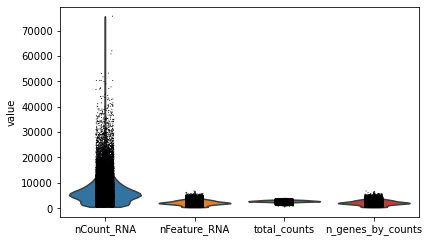

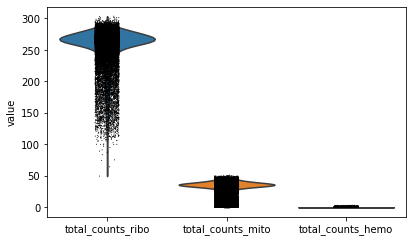

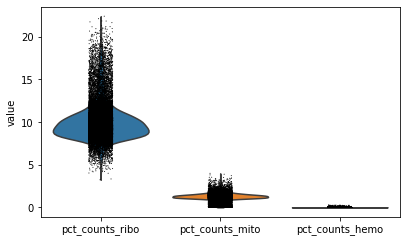

In [99]:
sc.pl.violin(adata, keys = ['nCount_RNA','nFeature_RNA', 'total_counts', 'n_genes_by_counts'])
sc.pl.violin(adata, keys = ['total_counts_ribo','total_counts_mito', 'total_counts_hemo'])
sc.pl.violin(adata, keys = ['pct_counts_ribo','pct_counts_mito', 'pct_counts_hemo'])

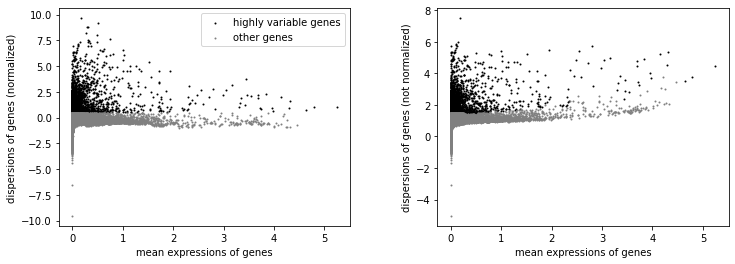

In [100]:
sc.pp.highly_variable_genes(adata, n_top_genes = 4000)
sc.pl.highly_variable_genes(adata)

In [101]:
adata.raw = adata

In [103]:
sc.pp.filter_genes(adata, min_cells=5)
sc.pp.filter_genes(adata, min_counts=10)

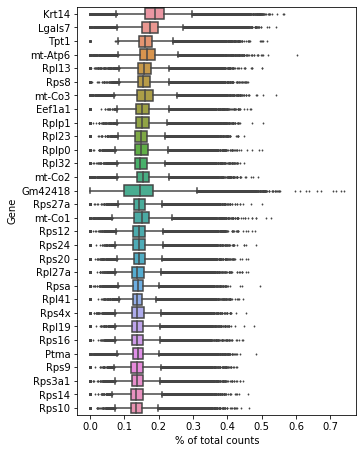

In [104]:
sc.pl.highest_expr_genes(adata)

In [105]:
sc.pp.scale(adata)

In [116]:
sc.pp.pca(adata)
sce.pp.harmony_integrate(adata, key = 'orig.ident')
#sc.pp.neighbors(adata, use_rep='X_pca_harmony')
bbknn.bbknn(adata, batch_key='orig.ident', use_rep='X_pca_harmony')
sc.tl.umap(adata, spread = 1)

2022-05-25 13:58:15,662 - harmonypy - INFO - Iteration 1 of 10
2022-05-25 13:58:24,451 - harmonypy - INFO - Iteration 2 of 10
2022-05-25 13:58:33,676 - harmonypy - INFO - Iteration 3 of 10
2022-05-25 13:58:42,293 - harmonypy - INFO - Iteration 4 of 10
2022-05-25 13:58:51,003 - harmonypy - INFO - Iteration 5 of 10
2022-05-25 13:58:59,699 - harmonypy - INFO - Iteration 6 of 10
2022-05-25 13:59:08,517 - harmonypy - INFO - Iteration 7 of 10
2022-05-25 13:59:17,414 - harmonypy - INFO - Iteration 8 of 10
2022-05-25 13:59:26,123 - harmonypy - INFO - Converged after 8 iterations


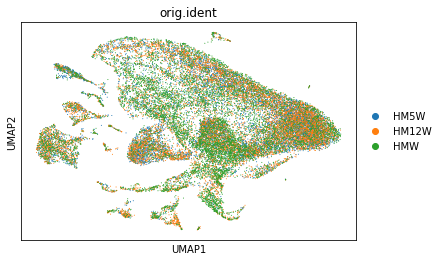

In [117]:
sc.pl.umap(adata, color = 'orig.ident')

In [118]:
sc.tl.leiden(adata, resolution = 0.3)

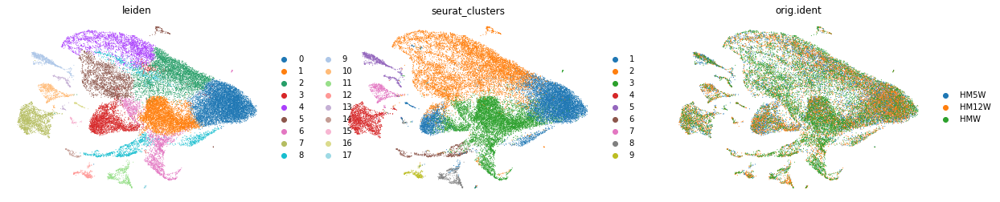

In [119]:
sc.pl.umap(adata, color = ['leiden', 'seurat_clusters', 'orig.ident'], frameon = False)

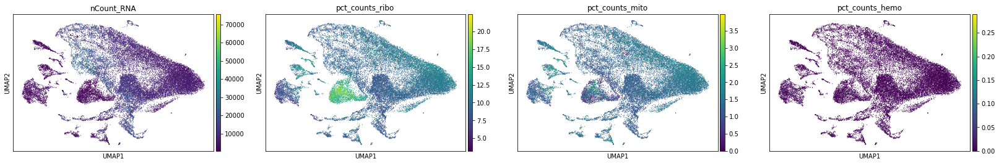

In [120]:
sc.pl.umap(adata, color = ['nCount_RNA', 'pct_counts_ribo','pct_counts_mito', 'pct_counts_hemo'])

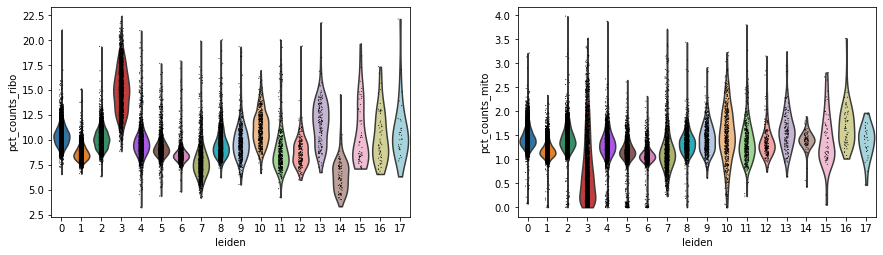

In [121]:
sc.pl.violin(adata, keys = ['pct_counts_ribo', 'pct_counts_mito'], groupby='leiden')

In [122]:
sum(adata.obs['leiden']=='5')

2057

In [123]:
sum(adata.obs['leiden']!='5')

26736

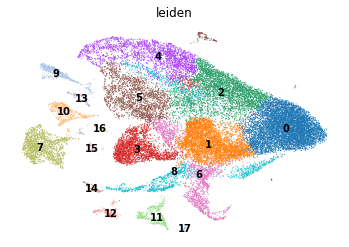

In [124]:
#sc.tl.leiden(adata, resolution = 0.5)
#sc.pl.umap(adata, color = ['leiden'])
sc.pl.umap(adata, color = ['leiden'], legend_loc='on data', frameon = False)

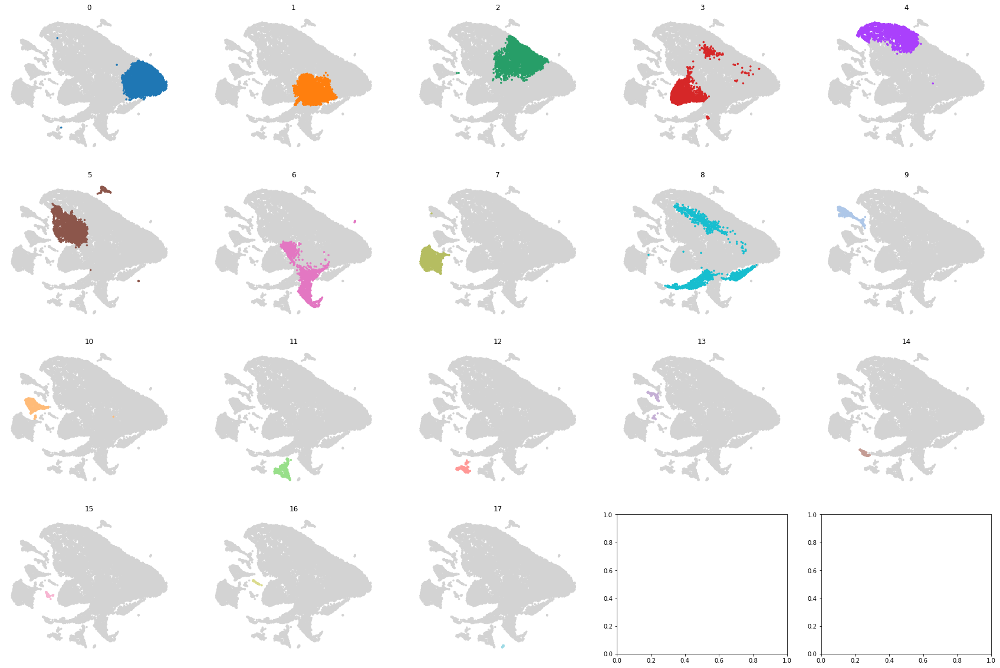

In [125]:
groups = adata.obs['leiden'].unique()
ncols = 5
fig, axes = initialize_subplots(len(groups), ncols = ncols, figsize_multiplier=(6,5))

for ix, g in enumerate(sorted(groups, key = lambda x: int(x))):
    ax = get_ax(axes, ix, ncols)
    sc.pl.umap(adata, color = 'leiden', ax = ax, show = False, frameon = False, groups = [g], legend_loc = 'on_data', title = g, s = 50)
clear_output()

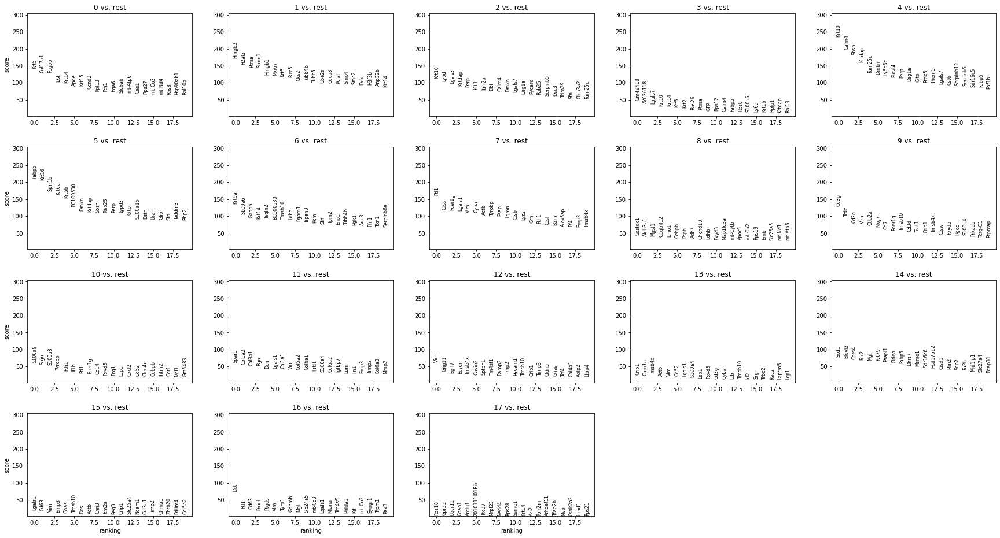

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17
0,Krt5,Hmgb2,Krt10,Gm42418,Krt10,Fabp5,Krt6a,Ftl1,Sostdc1,Cd3g,S100a9,Sparc,Vim,Crip1,Scd1,Lgals1,Dct,Rps18
1,Col17a1,H2afz,Ly6d,AY036118,Calm4,Krt16,S100a6,Ctss,Aldh3a1,Trdc,Srgn,Col1a2,Gng11,Coro1a,Elovl3,Cd63,Ftl1,Gpr22
2,Fcgbp,Ptma,Lgals3,Lgals7,Sbsn,Sprr1b,Gapdh,Fcer1g,Mgst1,Cd3e,S100a8,Col3a1,Egfl7,Tmsb4x,Cers4,Vim,Cd63,Uqcr11
3,Dst,Stmn1,Krtdap,Krt10,Krtdap,Krt6a,Krt14,Lgals1,C1qtnf12,Vim,Tyrobp,Bgn,Ecscr,Actb,Far2,Emp3,Pmel,Gnao1
4,Krt14,Hmgb1,Perp,Krt14,Fam25c,Krt6b,Tagln2,Vim,Lmo1,Ctla2a,Fth1,Dcn,Tmsb4x,Vim,Mgll,Gnas,Ptgds,Arglu1
5,Apoe,Mki67,Krt1,Krt5,Dmkn,BC100530,BC100530,Cyba,Cebpb,Nkg7,Il1b,Lgals1,Cavin2,Cd52,Krt79,Tmsb10,Vim,2010111I01Rik
6,Krt15,Krt5,Itm2b,Krt2,Ly6g6c,Dmkn,Tmsb10,Actb,Psph,Cd7,Ftl1,Col1a1,Sptbn1,Lgals1,Psapl1,Des,Tyrp1,Ttc37
7,Ccnd2,Birc5,Dbi,Rps26,Elovl4,Krtdap,Ldha,Tyrobp,Adh7,Fcer1g,Fcer1g,Vim,Tm4sf1,S100a4,Cidea,Actb,Gpnmb,Mrpl23
8,Rpl13,Cks2,Calm4,Ptma,Perp,Sbsn,Pgam1,Psap,Chchd10,Tmsb10,Cd14,Col5a2,Ramp2,Lsp1,Fabp5,Cnn3,Mgll,Nedd4
9,Fth1,Tubb4b,Dmkn,GFP,Dsg1a,Rab25,Tspan3,Lgmn,Ldhb,Cd3d,Fxyd5,Col6a1,Timp2,Fxyd5,Dhrs7,Itm2a,Slc24a5,Rps28


In [126]:
sc.tl.rank_genes_groups(adata, groupby = 'leiden')
sc.pl.rank_genes_groups(adata, ncols = 5)
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(20)

/home/karlan/miniconda3/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1227: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


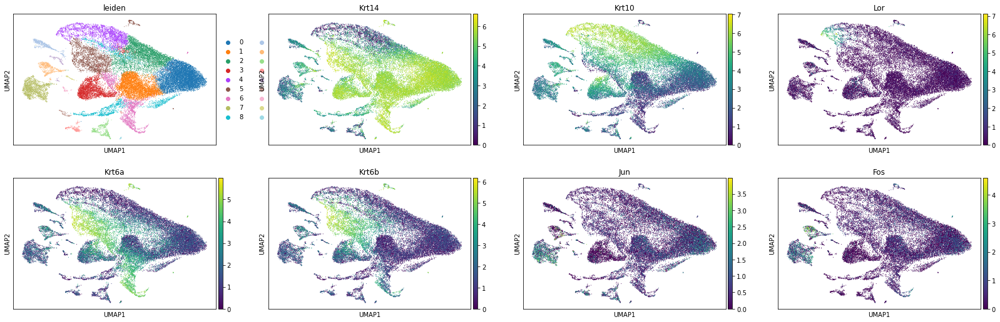

In [127]:
sc.pl.umap(adata, color = ['leiden', 'Krt14','Krt10','Lor', 'Krt6a','Krt6b','Jun','Fos'], groups = groups, ncols = 4)

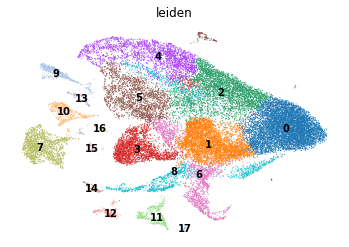

In [124]:
sc.pl.umap(adata, color = ['leiden'], legend_loc='on data', frameon = False)

## Remove KCs

In [128]:
KC_groups = ['0','1','2','3','4','5','6','8']

In [129]:
adata = adata[~adata.obs['leiden'].isin(KC_groups)].copy()

In [130]:
sc.pp.pca(adata)
sce.pp.harmony_integrate(adata, key = 'orig.ident')
sc.pp.neighbors(adata, use_rep='X_pca_harmony')
#bbknn.bbknn(adata, batch_key='orig.ident')
sc.tl.umap(adata, spread = 1)

2022-05-25 14:05:16,725 - harmonypy - INFO - Iteration 1 of 10
2022-05-25 14:05:17,586 - harmonypy - INFO - Iteration 2 of 10
2022-05-25 14:05:18,494 - harmonypy - INFO - Iteration 3 of 10
2022-05-25 14:05:19,469 - harmonypy - INFO - Iteration 4 of 10
2022-05-25 14:05:19,867 - harmonypy - INFO - Iteration 5 of 10
2022-05-25 14:05:20,981 - harmonypy - INFO - Iteration 6 of 10
2022-05-25 14:05:21,381 - harmonypy - INFO - Iteration 7 of 10
2022-05-25 14:05:21,716 - harmonypy - INFO - Iteration 8 of 10
2022-05-25 14:05:22,066 - harmonypy - INFO - Iteration 9 of 10
2022-05-25 14:05:22,427 - harmonypy - INFO - Iteration 10 of 10
2022-05-25 14:05:22,763 - harmonypy - INFO - Stopped before convergence


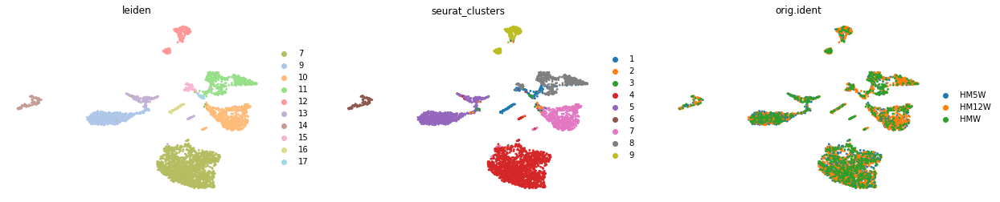

In [131]:
sc.pl.umap(adata, color = ['leiden', 'seurat_clusters', 'orig.ident'], frameon = False)

In [136]:
sc.tl.leiden(adata, resolution = 0.5)

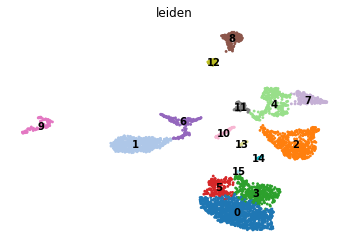

In [139]:
sc.pl.umap(adata, color = ['leiden'], legend_loc='on data', frameon = False, palette = 'tab20')

In [138]:
sc.tl.rank_genes_groups(adata, groupby = 'leiden')
sc.pl.rank_genes_groups(adata, ncols = 5)
clear_output()
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(20)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
0,Ctsb,Cd3g,S100a9,Ifitm3,Sparc,Lgals7,Rps3a1,Sparc,Cldn5,Scd1,Dct,Rpl7,Sparc,Cst3,Actb,Psap
1,Ctss,Trdc,S100a8,Fcgr1,Dcn,Krt14,Rps24,Col1a2,Gng11,Elovl3,Ptgds,Rpl23,Plvap,Actg1,Ccl6,Pgls
2,Lgmn,Cd3e,Srgn,Ftl1,Col1a2,Krt5,Rps15a,Col3a1,Mmrn1,Far2,Cd63,Rpl14,Fabp4,Tmsb4x,Ifitm1,Hsp90b1
3,Psap,Nkg7,Il1b,Ifi27l2a,Bgn,Ly6d,Rps16,Bgn,Egfl7,Mgll,Pmel,Rps15,Pecam1,Psmb8,Rps4x,Rpl31
4,Pf4,Ctla2a,Lgals7,Npc2,Col3a1,Apoe,Rpl23,Col8a1,Ecscr,Psapl1,Tyrp1,Rps23,Ehd4,Cxcl16,Rps11,mt-Co3
5,Ftl1,Cd7,Krt14,Ctss,Col1a1,Krtdap,Rps10,Abi3bp,Fgl2,Cers4,mt-Co3,Rpl10a,Ifitm3,Bcl2a1b,Serpinb1a,Rpl19
6,Ctsl,Cd3d,Krt10,Fcer1g,Fstl1,Pf4,Rpl27a,Mgp,Timp3,Krt79,mt-Nd1,Rpl11,Aqp1,Gadd45b,Rps9,H2-D1
7,Grn,Trat1,Krtdap,Tyrobp,Col6a1,Lgmn,Rpl10a,Ctgf,Cd9,Cidea,Mgll,Rps4x,Egfl7,Crip1,Gata2,Cst3
8,Lyz2,Ctsw,BC100530,Actb,Col5a2,Lyz2,Rpl11,Col1a1,Sptbn1,Msmo1,Slc24a5,Hsp90ab1,Igfbp7,Calm1,Fxyd5,Rpl32
9,Cyba,Rgcc,Calm4,Cyba,Fbn1,Ctss,Rpl18a,Pam,Cavin2,Dhrs7,mt-Nd2,Rpl37,Ctla2a,Samsn1,Rps24,Siglech


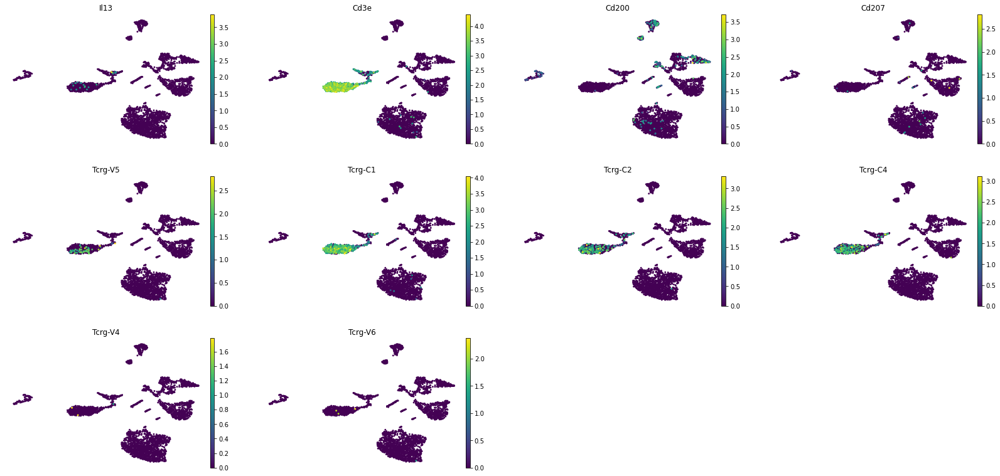

In [140]:
sc.pl.umap(adata, color = ['Il13', 'Cd3e', 'Cd200', 'Cd207', 'Tcrg-V5', 'Tcrg-C1', 'Tcrg-C2', 'Tcrg-C4', 'Tcrg-V4', 'Tcrg-V6'], legend_loc='on data', frameon = False)

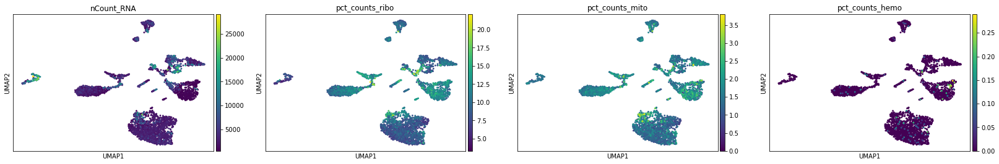

In [141]:
sc.pl.umap(adata, color = ['nCount_RNA', 'pct_counts_ribo','pct_counts_mito', 'pct_counts_hemo'])

## Save cells

In [144]:
path = '{}/My Drive/MKA/Papers/Greco/Sara and Nur/Loom files'.format(root)
filename = f'{sample}_validation_NonKC_RAW.loom'
adata.X = adata.raw[:, adata.var_names].X

In [145]:
adata.write_loom(os.path.join(path, filename), write_obsm_varm=True)

# HFU

In [146]:
sample = 'HFU'

In [147]:
path = '{}/My Drive/MKA/Papers/Greco/Sara and Nur/Loom files'.format(root)
filename = f'{sample}_validation.loom'

In [148]:
adata = sc.read_loom(os.path.join(path, filename), spec_version = 'old', validate = False)

In [149]:
raw_data = adata.copy()

In [150]:
adata.obs['seurat_clusters'] = adata.obs['seurat_clusters'].astype(str)
adata.var['ribo'] = adata.var_names.str.startswith('Rps') | adata.var_names.str.startswith('Rpl')
adata.var['mito'] = adata.var_names.str.startswith('mt')
adata.var['hemo'] = adata.var_names.str.startswith('Hba') | adata.var_names.str.startswith('Hbb')

In [151]:
adata

AnnData object with n_obs × n_vars = 31436 × 18891
    obs: 'Immune21', 'Infundibulum1', 'RBC1', 'RNA_snn_res.0.1', 'integrated_snn_res.0.1', 'nCount_RNA', 'nFeature_RNA', 'orig.ident', 'percent.mt', 'seurat_clusters'
    var: 'ribo', 'mito', 'hemo'
    layers: 'counts'

In [152]:
sc.pp.calculate_qc_metrics(adata, inplace = True, qc_vars = ['ribo','mito','hemo'])

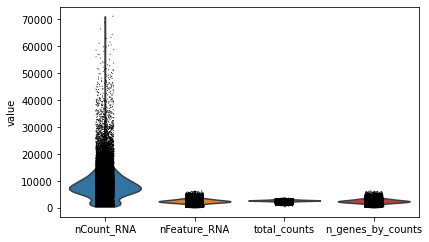

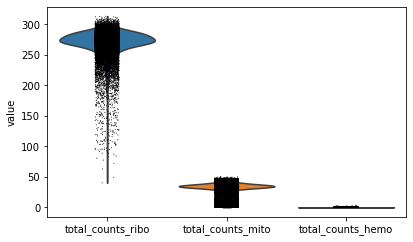

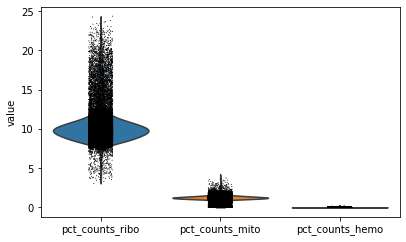

In [153]:
sc.pl.violin(adata, keys = ['nCount_RNA','nFeature_RNA', 'total_counts', 'n_genes_by_counts'])
sc.pl.violin(adata, keys = ['total_counts_ribo','total_counts_mito', 'total_counts_hemo'])
sc.pl.violin(adata, keys = ['pct_counts_ribo','pct_counts_mito', 'pct_counts_hemo'])

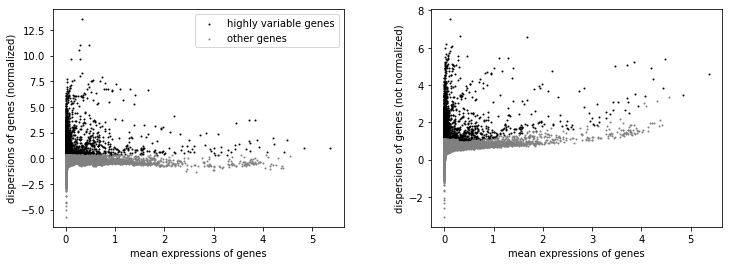

In [154]:
sc.pp.highly_variable_genes(adata, n_top_genes = 4000)
sc.pl.highly_variable_genes(adata)

In [155]:
adata.raw = adata

In [156]:
sc.pp.filter_genes(adata, min_cells=5)
sc.pp.filter_genes(adata, min_counts=10)

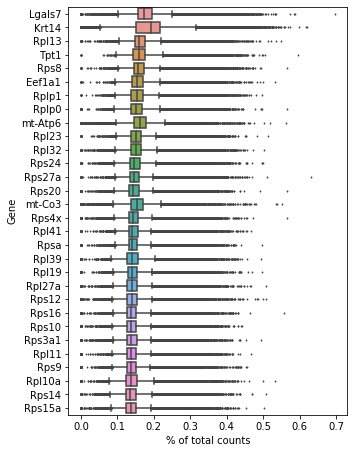

In [157]:
sc.pl.highest_expr_genes(adata)

In [158]:
sc.pp.scale(adata)

In [166]:
#sc.pp.pca(adata)
#sce.pp.harmony_integrate(adata, key = 'orig.ident')
#sc.pp.neighbors(adata, use_rep='X_pca_harmony')
bbknn.bbknn(adata, batch_key='orig.ident', use_rep='X_pca_harmony')
sc.tl.umap(adata, spread = 1)

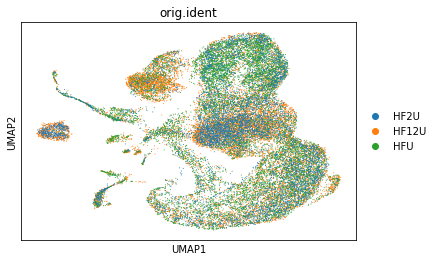

In [167]:
sc.pl.umap(adata, color = 'orig.ident')

In [168]:
sc.tl.leiden(adata, resolution = 0.3)

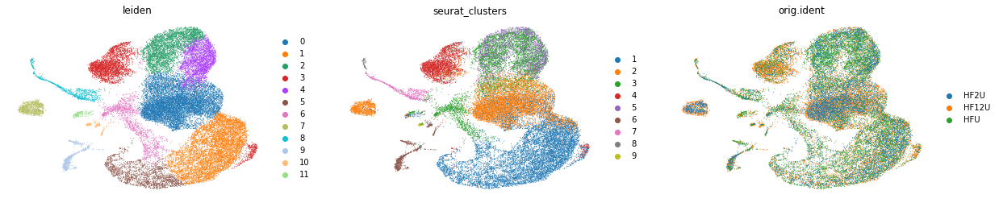

In [169]:
sc.pl.umap(adata, color = ['leiden', 'seurat_clusters', 'orig.ident'], frameon = False)

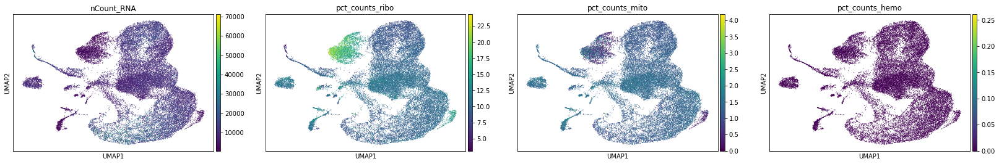

In [170]:
sc.pl.umap(adata, color = ['nCount_RNA', 'pct_counts_ribo','pct_counts_mito', 'pct_counts_hemo'])

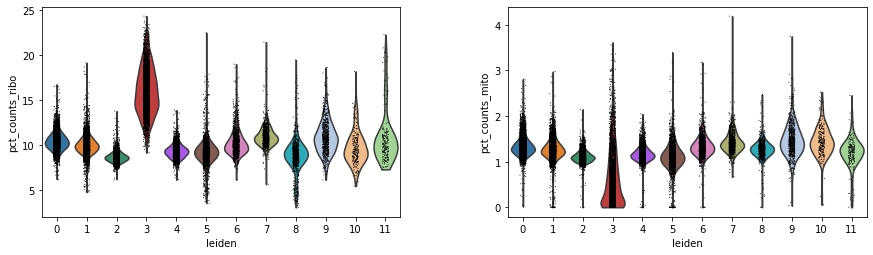

In [171]:
sc.pl.violin(adata, keys = ['pct_counts_ribo', 'pct_counts_mito'], groupby='leiden')

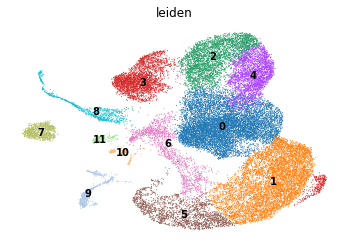

In [172]:
#sc.tl.leiden(adata, resolution = 0.5)
#sc.pl.umap(adata, color = ['leiden'])
sc.pl.umap(adata, color = ['leiden'], legend_loc='on data', frameon = False)

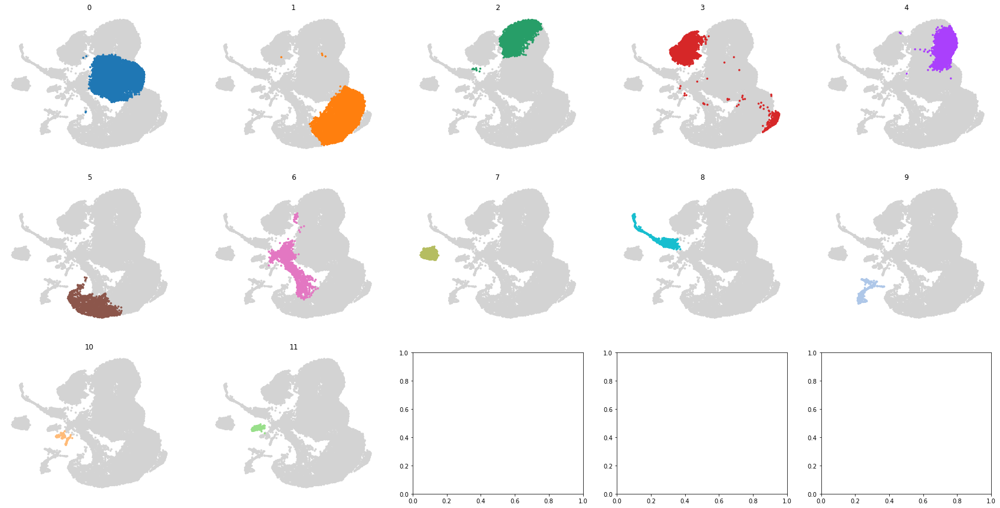

In [173]:
groups = adata.obs['leiden'].unique()
ncols = 5
fig, axes = initialize_subplots(len(groups), ncols = ncols, figsize_multiplier=(6,5))

for ix, g in enumerate(sorted(groups, key = lambda x: int(x))):
    ax = get_ax(axes, ix, ncols)
    sc.pl.umap(adata, color = 'leiden', ax = ax, show = False, frameon = False, groups = [g], legend_loc = 'on_data', title = g, s = 50)
clear_output()

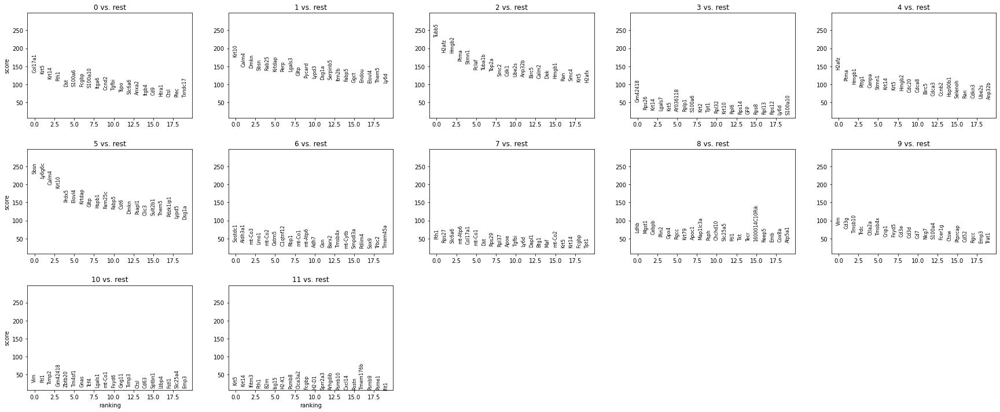

,0,1,2,3,4,5,6,7,8,9,10,11
0,Col17a1,Krt10,Tubb5,Gm42418,H2afz,Sbsn,Sostdc1,Fth1,Ldhb,Vim,Vim,Krt5
1,Krt5,Calm4,H2afz,Rps26,Ptma,Ly6g6c,Aldh3a1,Rps27,Mgst1,Cd3g,Ftl1,Krt14
2,Krt14,Dmkn,Hmgb2,Krt14,Hmgb1,Calm4,mt-Co3,Slc6a6,Cebpb,Tmsb10,Timp2,Ifitm3
3,Fth1,Sbsn,Ptma,Lgals7,Pttg1,Krt10,Lmo1,mt-Atp6,Plin2,Trdc,Gm42418,Fth1
4,Dst,Rab25,Stmn1,Krt5,Cenpa,Prdx5,mt-Co2,Col17a1,Gpx4,Ctla2a,Zbtb20,B2m
5,S100a6,Krtdap,Pclaf,AY036118,Stmn1,Elovl4,Gstm5,mt-Co1,Rgcc,Tmsb4x,Tm4sf1,Isg15
6,Fcgbp,Perp,Tuba1b,Rplp1,Krt14,Krtdap,C1qtnf12,Dst,Krt79,Crip1,Gnas,H2-K1
7,S100a10,Lgals3,Top2a,S100a6,Krt5,Gltp,Rbp1,Rps29,Apoc1,Fxyd5,Tcf4,Psmb8
8,Itga6,Gltp,Smc2,Krt2,Hmgb2,Hspb1,mt-Co1,Rpl37,Map1lc3a,Cd3e,Lgals1,Clca3a2
9,Ccnd2,Pycard,Cdk1,Tpt1,Cdc20,Fam25c,mt-Atp6,Apoe,Psph,Cd3d,mt-Co1,Fcgbp


In [174]:
sc.tl.rank_genes_groups(adata, groupby = 'leiden')
sc.pl.rank_genes_groups(adata, ncols = 5)
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(20)

/home/karlan/miniconda3/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1227: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


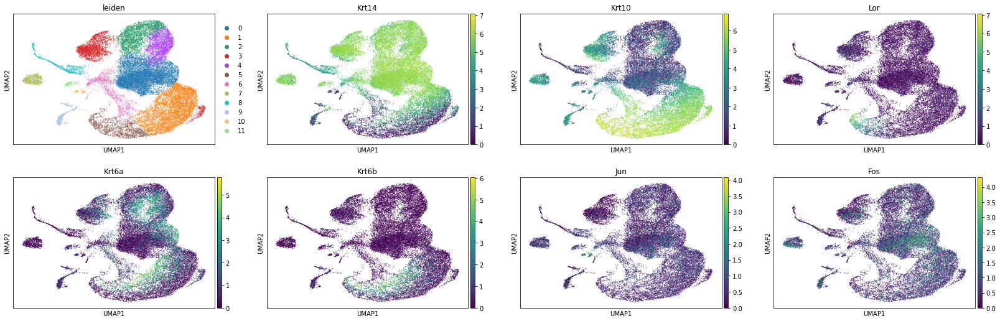

In [175]:
sc.pl.umap(adata, color = ['leiden', 'Krt14','Krt10','Lor', 'Krt6a','Krt6b','Jun','Fos'], groups = groups, ncols = 4)

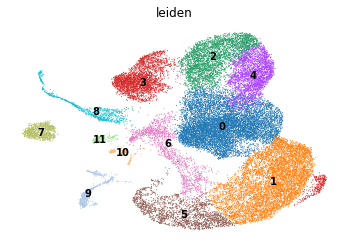

In [176]:
sc.pl.umap(adata, color = ['leiden'], legend_loc='on data', frameon = False)

## Remove KCs

In [177]:
KC_groups = ['0','1','2','3','4','5','6','8','11']

In [178]:
adata = adata[~adata.obs['leiden'].isin(KC_groups)].copy()

In [189]:
adata.obs['orig.ident'].unique()

['HF12U', 'HFU', 'HF2U']
Categories (3, object): ['HF2U', 'HF12U', 'HFU']

In [193]:
sc.pp.pca(adata)
#sce.pp.harmony_integrate(adata, key = 'orig.ident')
#sc.pp.neighbors(adata, use_rep='X_pca_harmony')
#sc.pp.neighbors(adata)
bbknn.bbknn(adata, batch_key='orig.ident')
sc.tl.umap(adata, spread = 1)

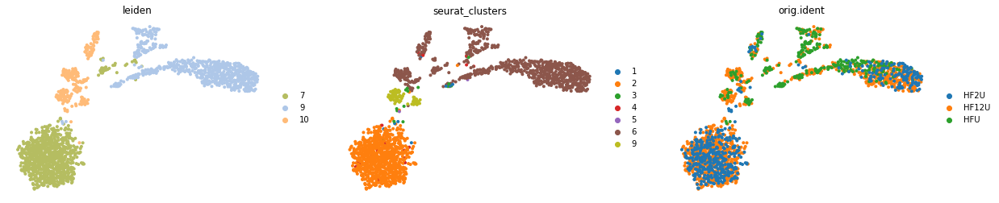

In [194]:
sc.pl.umap(adata, color = ['leiden', 'seurat_clusters', 'orig.ident'], frameon = False)

In [195]:
sc.tl.leiden(adata, resolution = 0.5)

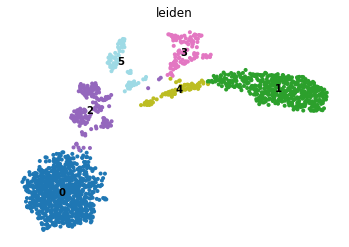

In [196]:
sc.pl.umap(adata, color = ['leiden'], legend_loc='on data', frameon = False, palette = 'tab20')

In [197]:
sc.tl.rank_genes_groups(adata, groupby = 'leiden')
sc.pl.rank_genes_groups(adata, ncols = 5)
clear_output()
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(20)


,0,1,2,3,4,5
0,Col17a1,Cd3g,Timp2,Cd52,Cd3g,Ftl1
1,Krt14,Trdc,Ftl1,Tmsb4x,Ctla2a,Cd63
2,Krt5,Cd7,Timp3,Lgals1,Lgals7,Dct
3,Ly6d,Ctla2a,Tcf4,Actb,Cd7,Pmel
4,Capns2,Cd3e,Ltbp4,Crip1,Trdc,Ptgds
5,Fxyd3,Nkg7,Zbtb20,Coro1a,Sfn,Phlda1
6,Fcgbp,Fcer1g,Fxyd6,Vim,BC100530,Tyrp1
7,Perp,Cd3d,Fstl1,Lsp1,Nkg7,Syngr1
8,Dst,Ctsw,Ifitm2,Fabp5,Fgfbp1,Gpnmb
9,Dapl1,Tmsb10,Sparc,Cyba,Cd3e,Lgals1


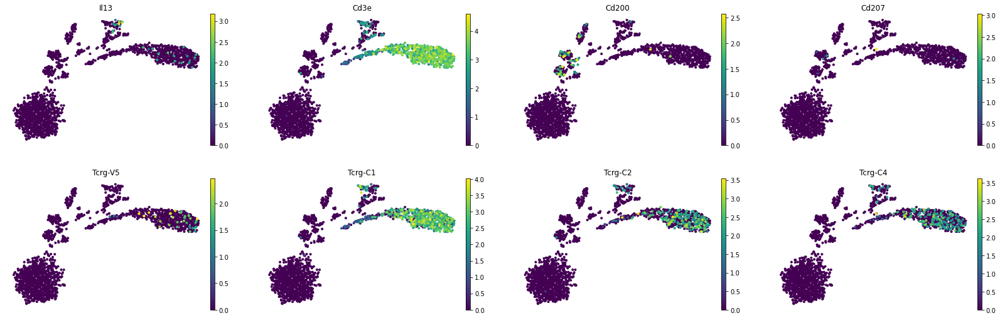

In [199]:
genes = ['Il13', 'Cd3e', 'Cd200', 'Cd207', 'Tcrg-V5', 'Tcrg-C1', 'Tcrg-C2', 'Tcrg-C4', 'Tcrg-V4', 'Tcrg-V6']
genes = [x for x in genes if x in adata.var_names]
sc.pl.umap(adata, color = genes, legend_loc='on data', frameon = False)

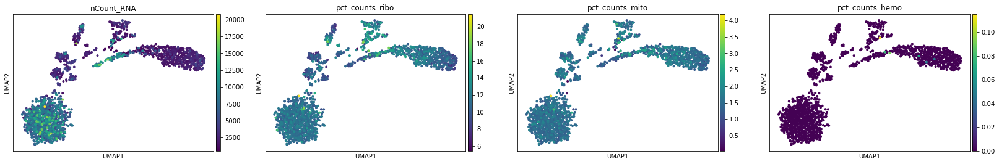

In [200]:
sc.pl.umap(adata, color = ['nCount_RNA', 'pct_counts_ribo','pct_counts_mito', 'pct_counts_hemo'])

## Save cells

In [201]:
path = '{}/My Drive/MKA/Papers/Greco/Sara and Nur/Loom files'.format(root)
filename = f'{sample}_validation_NonKC_RAW.loom'
adata.X = adata.raw[:, adata.var_names].X

In [202]:
adata.write_loom(os.path.join(path, filename), write_obsm_varm=True)

# HFW

In [3]:
sample = 'HFW'

In [4]:
path = '{}/My Drive/MKA/Papers/Greco/Sara and Nur/Loom files'.format(root)
filename = f'{sample}_validation.loom'

In [5]:
adata = sc.read_loom(os.path.join(path, filename), spec_version = 'old', validate = False)

In [6]:
raw_data = adata.copy()

In [7]:
adata.obs['seurat_clusters'] = adata.obs['seurat_clusters'].astype(str)
adata.var['ribo'] = adata.var_names.str.startswith('Rps') | adata.var_names.str.startswith('Rpl')
adata.var['mito'] = adata.var_names.str.startswith('mt')
adata.var['hemo'] = adata.var_names.str.startswith('Hba') | adata.var_names.str.startswith('Hbb')

In [8]:
adata

AnnData object with n_obs × n_vars = 26437 × 18881
    obs: 'Immune21', 'Infundibulum1', 'RBC1', 'RNA_snn_res.0.1', 'integrated_snn_res.0.1', 'nCount_RNA', 'nFeature_RNA', 'orig.ident', 'percent.mt', 'seurat_clusters'
    var: 'ribo', 'mito', 'hemo'
    layers: 'counts'

In [9]:
sc.pp.calculate_qc_metrics(adata, inplace = True, qc_vars = ['ribo','mito','hemo'])

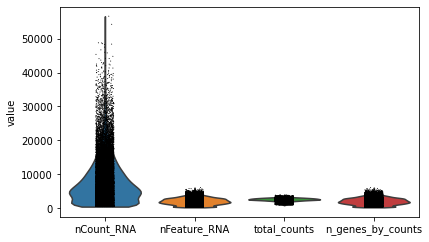

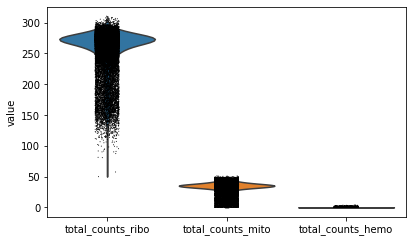

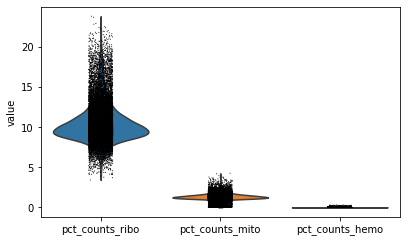

In [10]:
sc.pl.violin(adata, keys = ['nCount_RNA','nFeature_RNA', 'total_counts', 'n_genes_by_counts'])
sc.pl.violin(adata, keys = ['total_counts_ribo','total_counts_mito', 'total_counts_hemo'])
sc.pl.violin(adata, keys = ['pct_counts_ribo','pct_counts_mito', 'pct_counts_hemo'])

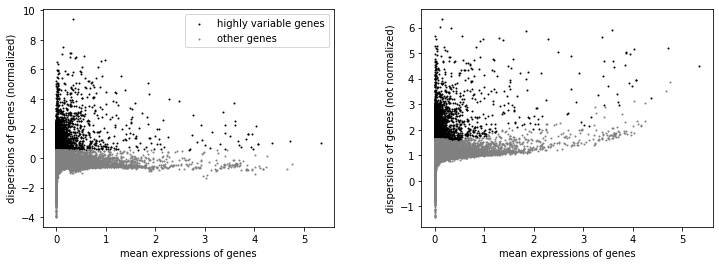

In [11]:
sc.pp.highly_variable_genes(adata, n_top_genes = 4000)
sc.pl.highly_variable_genes(adata)

In [12]:
adata.raw = adata

In [13]:
sc.pp.filter_genes(adata, min_cells=5)
sc.pp.filter_genes(adata, min_counts=10)

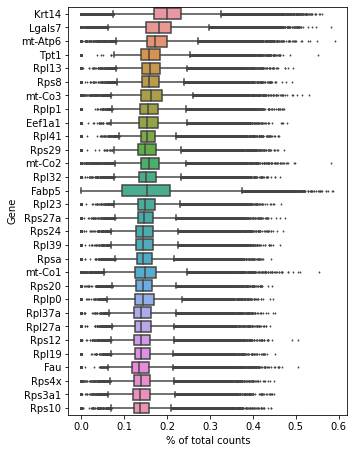

In [14]:
sc.pl.highest_expr_genes(adata)

In [15]:
sc.pp.scale(adata)

In [17]:
sc.pp.pca(adata)
sce.pp.harmony_integrate(adata, key = 'orig.ident')
#sc.pp.neighbors(adata, use_rep='X_pca_harmony')
bbknn.bbknn(adata, batch_key='orig.ident', use_rep='X_pca_harmony')
sc.tl.umap(adata, spread = 1)

2022-05-26 03:46:22,455 - harmonypy - INFO - Iteration 1 of 10
2022-05-26 03:46:33,198 - harmonypy - INFO - Iteration 2 of 10
2022-05-26 03:46:44,031 - harmonypy - INFO - Iteration 3 of 10
2022-05-26 03:46:59,319 - harmonypy - INFO - Iteration 4 of 10
2022-05-26 03:47:14,871 - harmonypy - INFO - Converged after 4 iterations


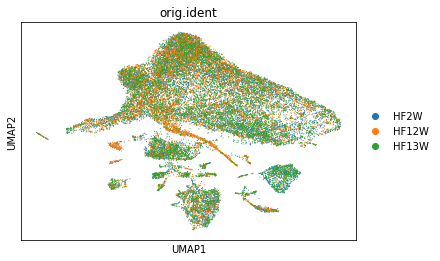

In [18]:
sc.pl.umap(adata, color = 'orig.ident')

In [19]:
sc.tl.leiden(adata, resolution = 0.3)

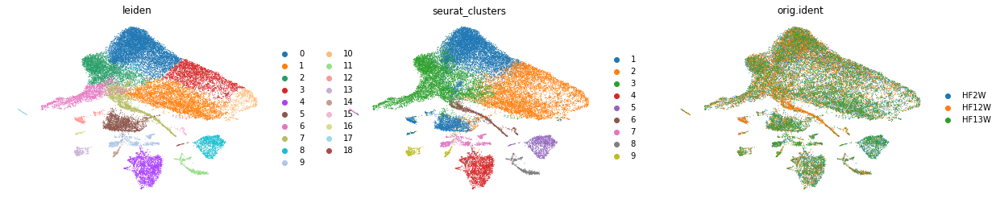

In [20]:
sc.pl.umap(adata, color = ['leiden', 'seurat_clusters', 'orig.ident'], frameon = False)

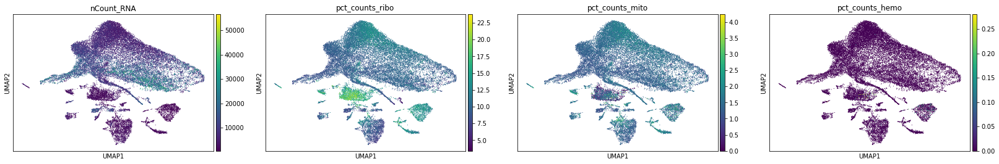

In [21]:
sc.pl.umap(adata, color = ['nCount_RNA', 'pct_counts_ribo','pct_counts_mito', 'pct_counts_hemo'])

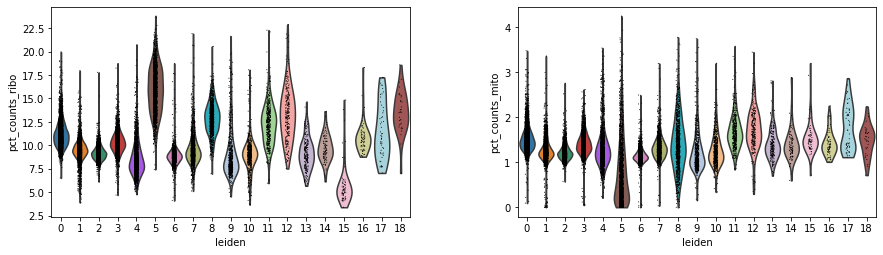

In [22]:
sc.pl.violin(adata, keys = ['pct_counts_ribo', 'pct_counts_mito'], groupby='leiden')

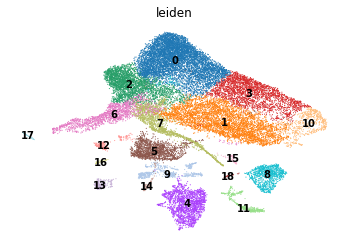

In [23]:
#sc.tl.leiden(adata, resolution = 0.5)
#sc.pl.umap(adata, color = ['leiden'])
sc.pl.umap(adata, color = ['leiden'], legend_loc='on data', frameon = False)

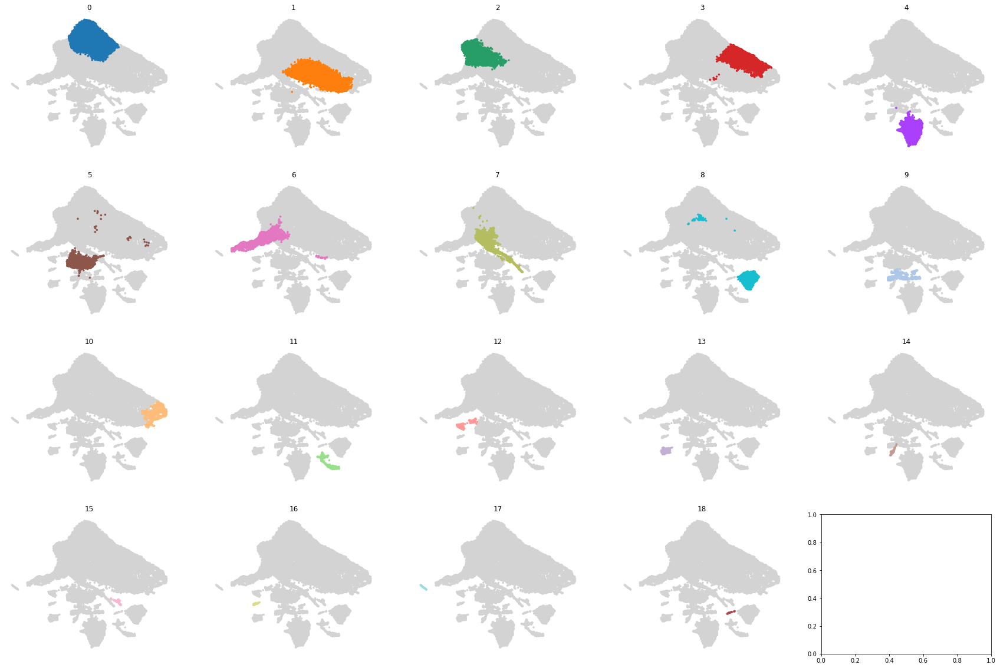

In [24]:
groups = adata.obs['leiden'].unique()
ncols = 5
fig, axes = initialize_subplots(len(groups), ncols = ncols, figsize_multiplier=(6,5))

for ix, g in enumerate(sorted(groups, key = lambda x: int(x))):
    ax = get_ax(axes, ix, ncols)
    sc.pl.umap(adata, color = 'leiden', ax = ax, show = False, frameon = False, groups = [g], legend_loc = 'on_data', title = g, s = 50)
clear_output()

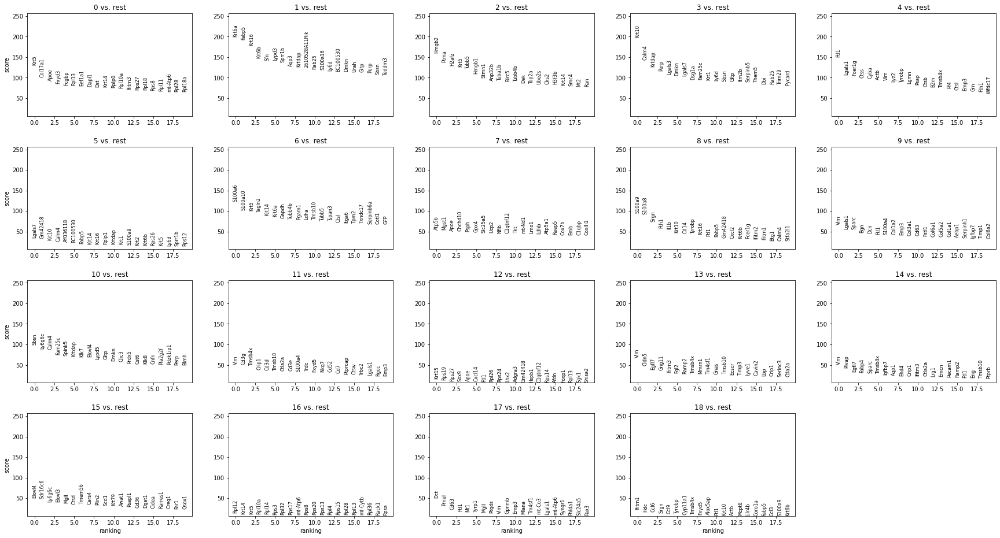

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18
0,Krt5,Krt6a,Hmgb2,Krt10,Ftl1,Lgals7,S100a6,Atp5b,S100a9,Vim,Sbsn,Vim,Krt15,Vim,Vim,Elovl4,Rpl12,Dct,Ifitm1
1,Col17a1,Fabp5,Ptma,Calm4,Lgals1,Gm42418,S100a10,Mgst1,S100a8,Lgals1,Ly6g6c,Cd3g,Rps19,Cldn5,Plvap,Sdr16c6,Krt14,Pmel,Hdc
2,Apoe,Krt16,H2afz,Krtdap,Fcer1g,Krt10,Krt5,Apoe,Srgn,Sparc,Calm4,Tmsb4x,Rps27,Egfl7,Egfl7,Ly6g6c,Krt5,Cd63,Ccl6
3,Fxyd3,Krt6b,Krt5,Perp,Ctss,Calm4,Tagln2,Chchd10,Fth1,Bgn,Fam25c,Crip1,Sox9,Gng11,Fabp4,Elovl3,Rpl10a,Ftl1,Srgn
4,Fcgbp,Sfn,Tubb5,Lgals3,Cyba,AY036118,Krt14,Psph,Il1b,Dcn,Spink5,Cd3d,Apoe,Ifitm3,Sparc,Mgll,Rpl14,Mt1,Ccl9
5,Rpl13,Lypd3,Hmgb1,Dmkn,Actb,BC100530,Krt6a,Gpx4,Krt10,Ftl1,Krtdap,Tmsb10,Cxcl14,Fgl2,Tmsb4x,Ctsd,Rps3,Tyrp1,Tyrobp
6,Eef1a1,Sprr1b,Stmn1,Lgals7,Vim,Fabp5,Gapdh,Slc25a5,Cd14,S100a4,Klk7,Ctla2a,Ftl1,Ramp2,Igfbp7,Tmem56,Rpl32,Mgll,Cyp11a1
7,Dapl1,Aqp3,Anp32b,Dsg1a,Lyz2,Krt14,Tubb4b,Ucp2,Tyrobp,Col1a2,Elovl4,Cd3e,Rpl26,Tmsb4x,Aqp1,Cers4,Rps17,Ptgds,Tmsb4x
8,Dst,Krtdap,Tuba1b,Fam25c,Tyrobp,Krt16,Pgam1,Nfib,Krt16,Emp3,Lypd5,S100a4,Rps24,Mmrn1,Ehd4,Plin2,mt-Atp6,Vim,Fxyd5
9,Krt14,2610528A11Rik,Birc5,Krt1,Lgmn,Rplp1,Ldha,C1qtnf12,Ftl1,Col3a1,Gltp,Trdc,Lhx2,Tm4sf1,Crip1,Scd1,Rps8,Gpnmb,Alox5ap


In [25]:
sc.tl.rank_genes_groups(adata, groupby = 'leiden')
sc.pl.rank_genes_groups(adata, ncols = 5)
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(20)

/home/karlan/miniconda3/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1227: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


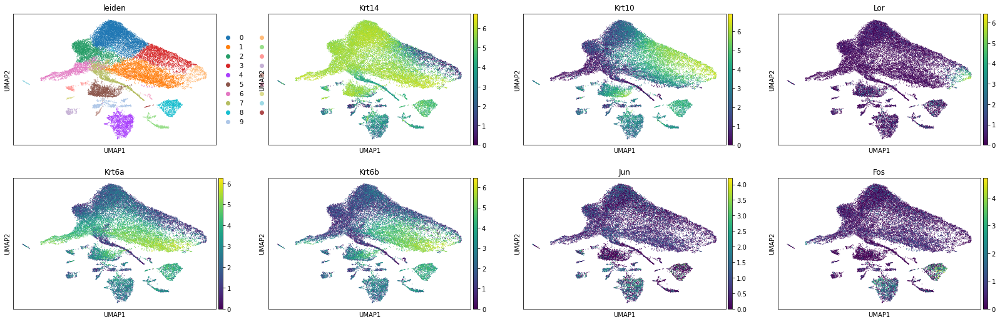

In [26]:
sc.pl.umap(adata, color = ['leiden', 'Krt14','Krt10','Lor', 'Krt6a','Krt6b','Jun','Fos'], groups = groups, ncols = 4)

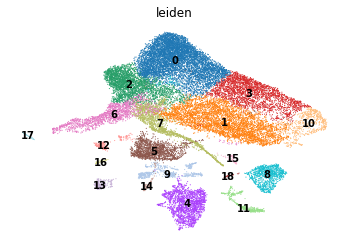

In [27]:
sc.pl.umap(adata, color = ['leiden'], legend_loc='on data', frameon = False)

## Remove KCs

In [28]:
KC_groups = ['0','1','2','3','5','6', '7', '8', '10']

In [29]:
adata = adata[~adata.obs['leiden'].isin(KC_groups)].copy()

In [31]:
sc.pp.pca(adata)
sce.pp.harmony_integrate(adata, key = 'orig.ident')
#sc.pp.neighbors(adata, use_rep='X_pca_harmony')
#sc.pp.neighbors(adata)
bbknn.bbknn(adata, batch_key='orig.ident', use_rep='X_pca_harmony')
sc.tl.umap(adata, spread = 1)

2022-05-26 04:09:56,498 - harmonypy - INFO - Iteration 1 of 10
2022-05-26 04:09:58,446 - harmonypy - INFO - Iteration 2 of 10
2022-05-26 04:09:59,900 - harmonypy - INFO - Iteration 3 of 10
2022-05-26 04:10:01,169 - harmonypy - INFO - Iteration 4 of 10
2022-05-26 04:10:01,958 - harmonypy - INFO - Iteration 5 of 10
2022-05-26 04:10:02,565 - harmonypy - INFO - Iteration 6 of 10
2022-05-26 04:10:03,216 - harmonypy - INFO - Converged after 6 iterations


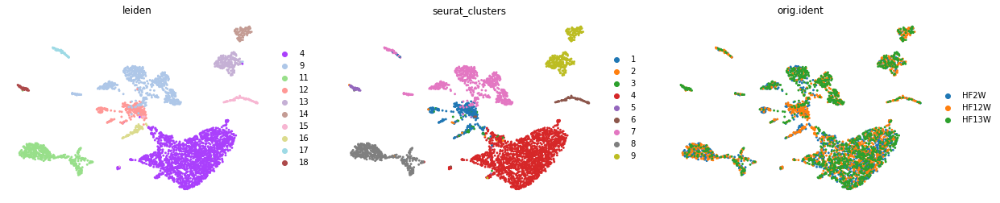

In [32]:
sc.pl.umap(adata, color = ['leiden', 'seurat_clusters', 'orig.ident'], frameon = False)

In [33]:
sc.tl.leiden(adata, resolution = 0.5)

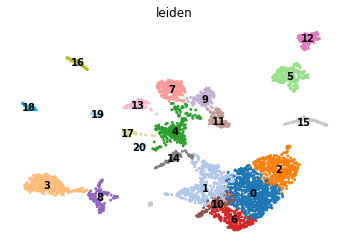

In [34]:
sc.pl.umap(adata, color = ['leiden'], legend_loc='on data', frameon = False, palette = 'tab20')

In [35]:
sc.tl.rank_genes_groups(adata, groupby = 'leiden')
sc.pl.rank_genes_groups(adata, ncols = 5)
clear_output()
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(20)


,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,20
0,Ctsb,Lyz2,Pf4,Cd3g,Rpl13,Cldn5,Srgn,Timp1,Cd52,Sparc,...,Dcn,Plvap,Sparc,Lgals7,Fabp5,Dct,Rpl10a,Ifitm1,Ppp1r14b,Lgals7
1,Ctss,Krt10,Lgmn,Trdc,Perp,Egfl7,Ftl1,Eif5a,Rps24,Col3a1,...,Col3a1,Egfl7,Col1a2,Krt14,Sdr16c6,Pmel,Rps8,Hdc,Rpl3,Dsc3
2,Lgmn,Krt14,Ctsb,Nkg7,Fxyd3,Gng11,Lgals3,Ran,Tmsb4x,Dcn,...,Col1a2,Fabp4,Col3a1,Fxyd3,Ly6g6c,Mt1,Rpl18a,Ccl6,Uqcrh,Perp
3,Ftl1,Ccr2,Mrc1,Cd3e,Krt5,Fgl2,Fth1,Tm4sf1,Ptprcap,Bgn,...,Sparc,Sparc,Mgp,Rps20,Elovl4,Cd63,Rpsa,Cyp11a1,Cd63,Rpl32
4,Pf4,Calm4,Ctss,Cd7,Lgals7,Mmrn1,Cd14,Npm1,Coro1a,Col1a2,...,Bgn,Aqp1,Bgn,Krt5,Tmem56,Tyrp1,Rpl13,Krt14,Rpl23a,Sfn
5,Psap,Tyrobp,Dab2,Ctla2a,Rpl12,Ifitm3,Cstb,Aebp1,Rps4x,Col1a1,...,Fstl1,Igfbp7,Col8a1,Rpl10a,Cers4,Mgll,Rps20,Krt10,Rps12,Rpl14
6,Fcer1g,Tgfbi,Fcer1g,Cd3d,Krt15,Ramp2,Vim,Hsp90aa1,Rps27,Serpinh1,...,Col1a1,Lrg1,Ctgf,Rpl12,Elovl3,Ptgds,Rps6,Calm4,Rpl5,Krt75
7,Ctsl,Krtdap,Wfdc17,Ctsw,Rps19,Lyve1,Pkm,Eef1g,Rpl19,Fstl1,...,Lum,Ifitm3,Dcn,Rpl32,Awat1,Rps25,Rpl36,Ccl9,Rps26,S100a14
8,Lyz2,BC100530,Ftl1,Rgcc,Rps20,Ecscr,Adam8,Hsp90ab1,Rpsa,Cd63,...,Pcolce,Ehd4,Igfbp7,Rpl13,Scd1,Mlana,Rps10,Srgn,Rps17,Cd9
9,Cyba,Lgals7,Grn,Trat1,Rps26,Gnas,Actb,Ncl,Ltb,Fbln2,...,Igfbp7,Id3,Abi3bp,Rpsa,Mgll,Gpnmb,Rps21,Fabp5,Rpl7,Eef1a1


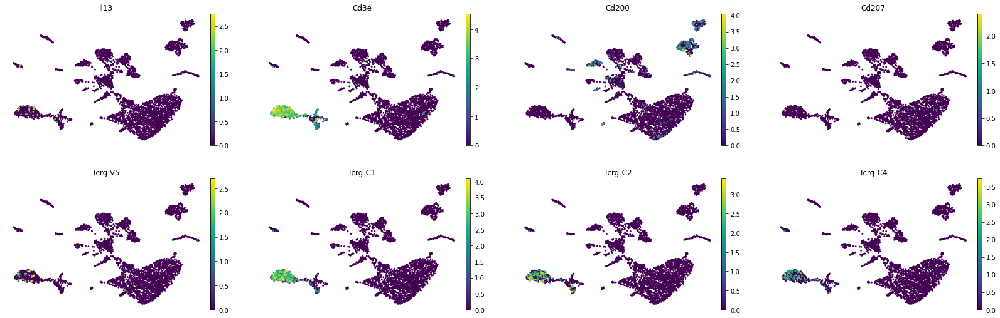

In [36]:
genes = ['Il13', 'Cd3e', 'Cd200', 'Cd207', 'Tcrg-V5', 'Tcrg-C1', 'Tcrg-C2', 'Tcrg-C4', 'Tcrg-V4', 'Tcrg-V6']
genes = [x for x in genes if x in adata.var_names]
sc.pl.umap(adata, color = genes, legend_loc='on data', frameon = False)

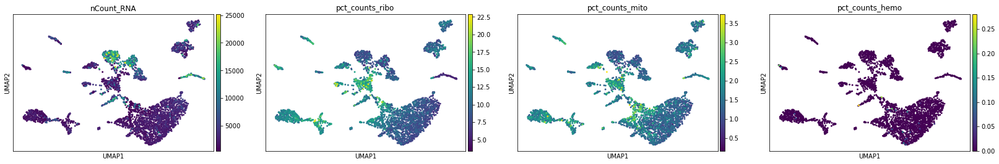

In [37]:
sc.pl.umap(adata, color = ['nCount_RNA', 'pct_counts_ribo','pct_counts_mito', 'pct_counts_hemo'])

## Save cells

In [38]:
path = '{}/My Drive/MKA/Papers/Greco/Sara and Nur/Loom files'.format(root)
filename = f'{sample}_validation_NonKC_RAW.loom'
adata.X = adata.raw[:, adata.var_names].X

In [39]:
adata.write_loom(os.path.join(path, filename), write_obsm_varm=True)

# WTMU

In [56]:
sample = 'WTMU'

In [57]:
path = '{}/My Drive/MKA/Papers/Greco/Sara and Nur/Loom files'.format(root)
filename = 'WTMU_integrated_filtered.loom'

In [58]:
#adata = sc.read_loom(os.path.join(path, filename), spec_version = 'old', validate = False)
adata = sc.read_loom(os.path.join(path, filename), validate = True, cleanup = True)

In [59]:
raw_data = adata.copy()

In [60]:
adata.obs['seurat_clusters'] = adata.obs['seurat_clusters'].astype(str)
adata.var['ribo'] = adata.var_names.str.startswith('Rps') | adata.var_names.str.startswith('Rpl')
adata.var['mito'] = adata.var_names.str.startswith('mt')
adata.var['hemo'] = adata.var_names.str.startswith('Hba') | adata.var_names.str.startswith('Hbb')

In [61]:
adata

AnnData object with n_obs × n_vars = 30188 × 18881
    obs: 'Immune21', 'Infundibulum1', 'RBC1', 'RNA_snn_res.0.1', 'integrated_snn_res.0.1', 'nCount_RNA', 'nFeature_RNA', 'orig.ident', 'percent.mt', 'seurat_clusters', 'tdt_info'
    var: 'ribo', 'mito', 'hemo'
    layers: 'counts'

In [62]:
sc.pp.calculate_qc_metrics(adata, inplace = True, qc_vars = ['ribo','mito','hemo'])

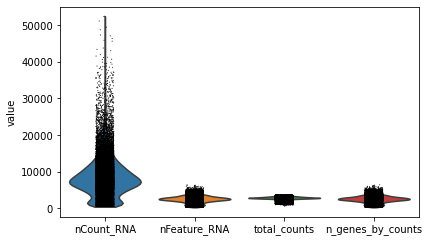

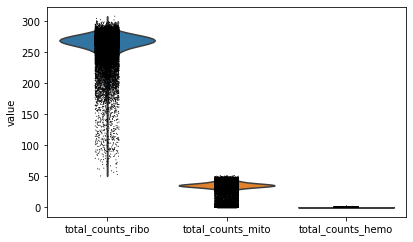

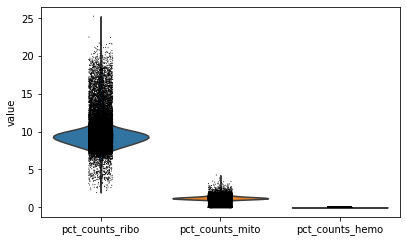

In [63]:
sc.pl.violin(adata, keys = ['nCount_RNA','nFeature_RNA', 'total_counts', 'n_genes_by_counts'])
sc.pl.violin(adata, keys = ['total_counts_ribo','total_counts_mito', 'total_counts_hemo'])
sc.pl.violin(adata, keys = ['pct_counts_ribo','pct_counts_mito', 'pct_counts_hemo'])

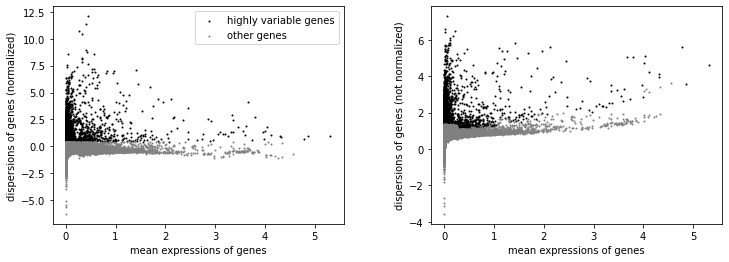

In [64]:
sc.pp.highly_variable_genes(adata, n_top_genes = 4000)
sc.pl.highly_variable_genes(adata)

In [65]:
adata.raw = adata

In [66]:
sc.pp.filter_genes(adata, min_cells=5)
sc.pp.filter_genes(adata, min_counts=10)

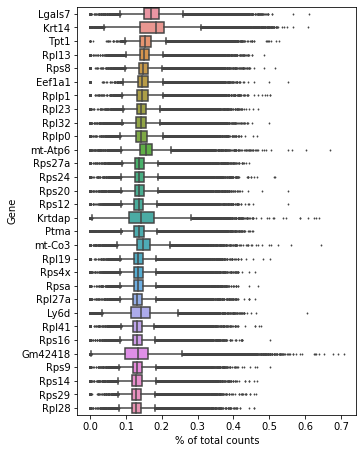

In [67]:
sc.pl.highest_expr_genes(adata)

In [68]:
sc.pp.scale(adata)

In [69]:
sc.pp.pca(adata)
sce.pp.harmony_integrate(adata, key = 'orig.ident')
#sc.pp.neighbors(adata, use_rep='X_pca_harmony')
bbknn.bbknn(adata, batch_key='orig.ident', use_rep='X_pca_harmony')
sc.tl.umap(adata, spread = 1)

2022-05-27 01:28:12,406 - harmonypy - INFO - Iteration 1 of 10
2022-05-27 01:28:32,265 - harmonypy - INFO - Iteration 2 of 10
2022-05-27 01:28:45,525 - harmonypy - INFO - Iteration 3 of 10
2022-05-27 01:28:58,975 - harmonypy - INFO - Iteration 4 of 10
2022-05-27 01:29:12,488 - harmonypy - INFO - Iteration 5 of 10
2022-05-27 01:29:34,946 - harmonypy - INFO - Converged after 5 iterations


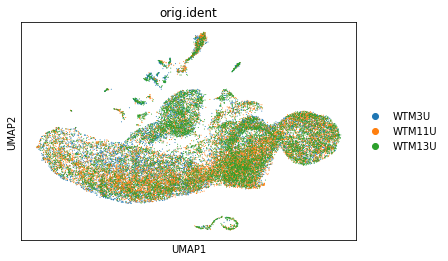

In [70]:
sc.pl.umap(adata, color = 'orig.ident')

In [71]:
sc.tl.leiden(adata, resolution = 0.3)

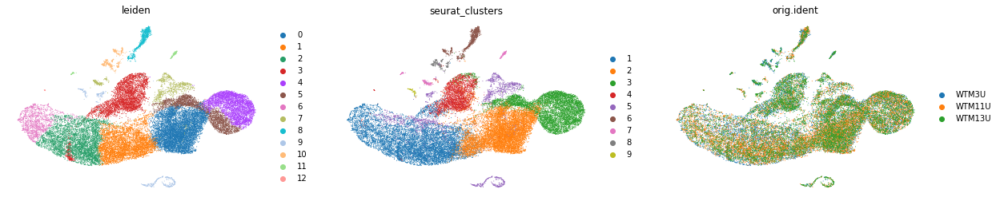

In [72]:
sc.pl.umap(adata, color = ['leiden', 'seurat_clusters', 'orig.ident'], frameon = False)

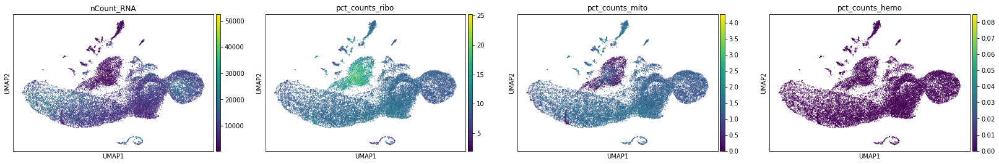

In [73]:
sc.pl.umap(adata, color = ['nCount_RNA', 'pct_counts_ribo','pct_counts_mito', 'pct_counts_hemo'])

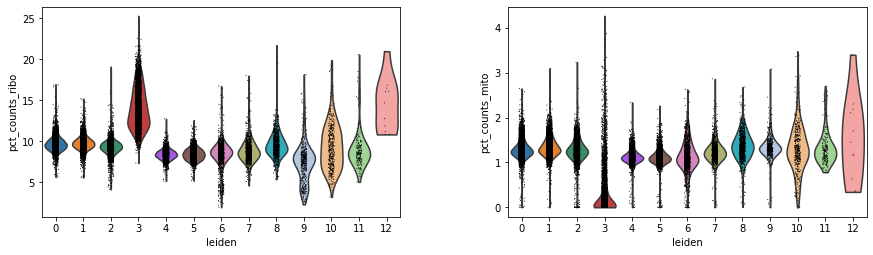

In [74]:
sc.pl.violin(adata, keys = ['pct_counts_ribo', 'pct_counts_mito'], groupby='leiden')

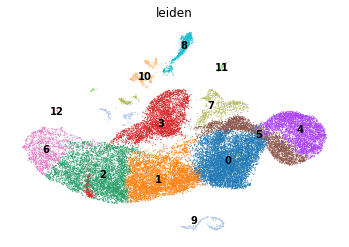

In [75]:
#sc.tl.leiden(adata, resolution = 0.5)
#sc.pl.umap(adata, color = ['leiden'])
sc.pl.umap(adata, color = ['leiden'], legend_loc='on data', frameon = False)

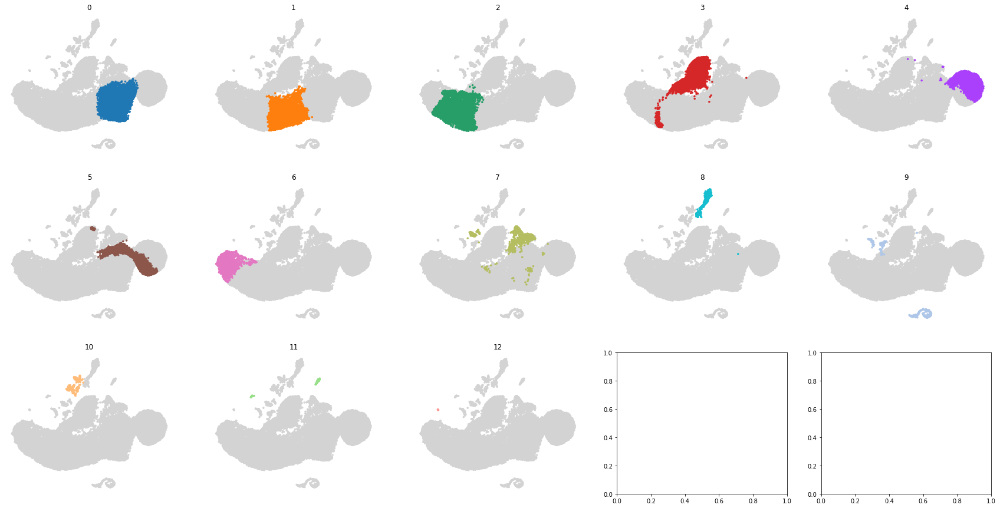

In [76]:
groups = adata.obs['leiden'].unique()
ncols = 5
fig, axes = initialize_subplots(len(groups), ncols = ncols, figsize_multiplier=(6,5))

for ix, g in enumerate(sorted(groups, key = lambda x: int(x))):
    ax = get_ax(axes, ix, ncols)
    sc.pl.umap(adata, color = 'leiden', ax = ax, show = False, frameon = False, groups = [g], legend_loc = 'on_data', title = g, s = 50)
clear_output()

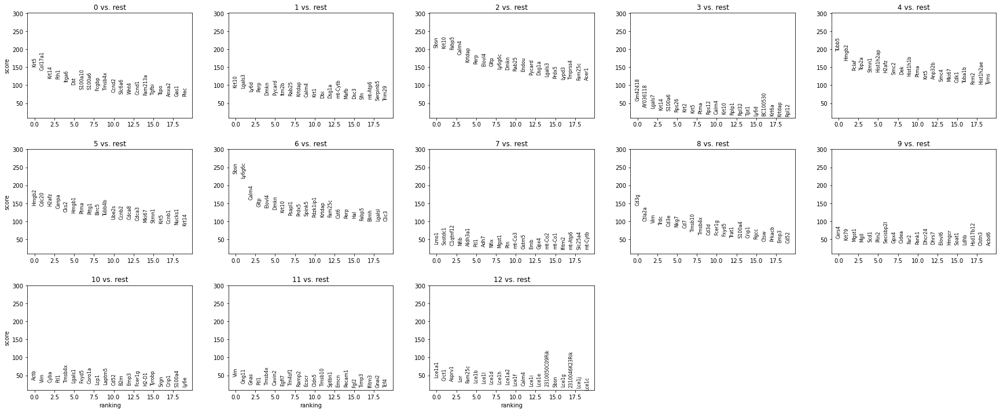

,0,1,2,3,4,5,6,7,8,9,10,11,12
0,Krt5,Krt10,Sbsn,Gm42418,Tubb5,Hmgb2,Sbsn,Lmo1,Cd3g,Cers4,Actb,Vim,Lce1a1
1,Col17a1,Lgals3,Krt10,AY036118,Hmgb2,Cdc20,Ly6g6c,Sostdc1,Ctla2a,Krt79,Vim,Gng11,Crct1
2,Krt14,Ly6d,Fabp5,Lgals7,Pclaf,H2afz,Calm4,C1qtnf12,Vim,Mgst1,Cyba,Gnas,Asprv1
3,Fth1,Perp,Calm4,Krt14,Top2a,Cenpa,Gltp,Nfib,Trdc,Mgll,Ftl1,Ftl1,Lor
4,Itga6,Dmkn,Krtdap,S100a6,Stmn1,Cks2,Elovl4,Aldh3a1,Cd3e,Scd1,Tmsb4x,Tmsb4x,Fam25c
5,Dst,Pycard,Perp,Rps26,Hist1h2ap,Hmgb1,Dmkn,Ftl1,Nkg7,Plin2,Lgals1,Cavin2,Lce1b
6,S100a10,Itm2b,Elovl4,Krt2,H2afz,Ptma,Krt10,Adh7,Cd7,Secisbp2l,Fxyd5,Egfl7,Lce1l
7,S100a6,Rab25,Gltp,Krt5,Smc2,Pttg1,Psapl1,Nfix,Tmsb10,Gpx4,Coro1a,Tm4sf1,Lce1d
8,Fcgbp,Krtdap,Ly6g6c,Ptma,Dek,Birc5,Prdx5,Mgst1,Tmsb4x,Cidea,Lcp1,Ramp2,Lce1h
9,Tmsb4x,Calm4,Dmkn,Rps12,Hist1h1b,Tubb4b,Spink5,Ptn,Cd3d,Far2,Laptm5,Ecscr,Lce1a2


In [77]:
sc.tl.rank_genes_groups(adata, groupby = 'leiden')
sc.pl.rank_genes_groups(adata, ncols = 5)
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(20)

/home/karlan/miniconda3/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1227: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


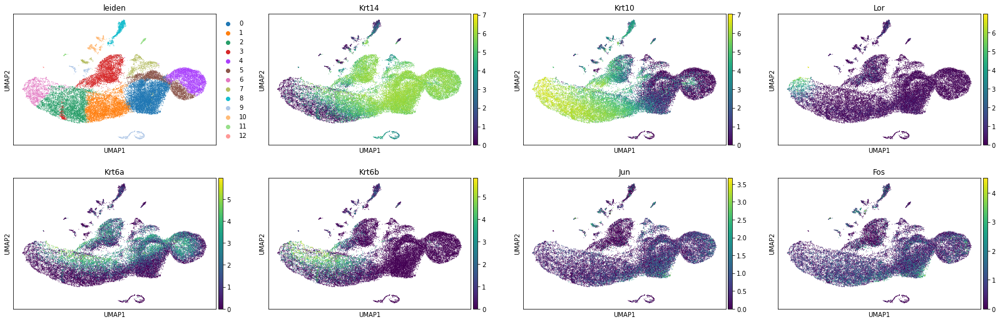

In [78]:
sc.pl.umap(adata, color = ['leiden', 'Krt14','Krt10','Lor', 'Krt6a','Krt6b','Jun','Fos'], groups = groups, ncols = 4)

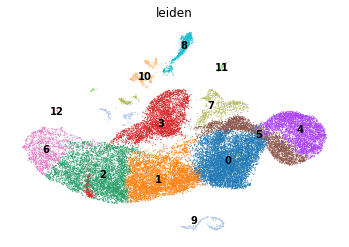

In [79]:
sc.pl.umap(adata, color = ['leiden'], legend_loc='on data', frameon = False)

## Remove KCs

In [80]:
KC_groups = ['0','1','2','3','4','5','6', '7', '9', '12']

In [81]:
adata = adata[~adata.obs['leiden'].isin(KC_groups)].copy()

In [82]:
sc.pp.pca(adata)
sce.pp.harmony_integrate(adata, key = 'orig.ident')
#sc.pp.neighbors(adata, use_rep='X_pca_harmony')
#sc.pp.neighbors(adata)
bbknn.bbknn(adata, batch_key='orig.ident', use_rep='X_pca_harmony')
sc.tl.umap(adata, spread = 1)

2022-05-27 01:30:27,719 - harmonypy - INFO - Iteration 1 of 10
2022-05-27 01:30:29,757 - harmonypy - INFO - Iteration 2 of 10
2022-05-27 01:30:30,957 - harmonypy - INFO - Iteration 3 of 10
2022-05-27 01:30:31,701 - harmonypy - INFO - Iteration 4 of 10
2022-05-27 01:30:31,891 - harmonypy - INFO - Converged after 4 iterations


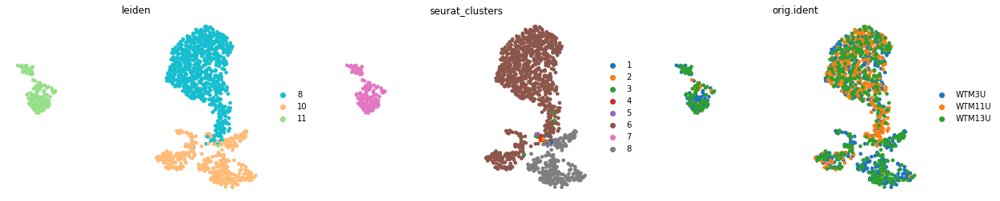

In [83]:
sc.pl.umap(adata, color = ['leiden', 'seurat_clusters', 'orig.ident'], frameon = False)

In [84]:
sc.tl.leiden(adata, resolution = 0.5)

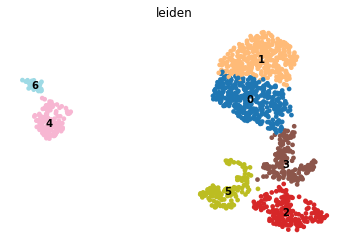

In [85]:
sc.pl.umap(adata, color = ['leiden'], legend_loc='on data', frameon = False, palette = 'tab20')

In [86]:
sc.tl.rank_genes_groups(adata, groupby = 'leiden')
sc.pl.rank_genes_groups(adata, ncols = 5)
clear_output()
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(20)


,0,1,2,3,4,5,6
0,Cd3g,Trdc,Ctss,Lgals7,Cldn5,Actb,Sparc
1,Cd7,Cd3g,Psap,Ly6d,Gng11,Lgals1,Plvap
2,Cd3e,Nkg7,Ftl1,Sfn,Mmrn1,Cd52,Egfl7
3,Nkg7,Ctla2a,Tyrobp,Krt14,Cd9,Rps15a,Igfbp7
4,Ctla2a,Cd3e,Ctsb,GFP,Fgl2,Rps24,Fabp4
5,Trat1,Cd3d,Cyba,Fxyd3,Crip2,Il7r,Ehd4
6,Trdc,Cd7,Lyz2,Perp,Cavin2,Rps16,Ifitm3
7,Prkacb,Ctsw,Lgmn,Krtdap,Fxyd6,Coro1a,Ptprb
8,Rgcc,Tmsb10,Alox5ap,Dmkn,Ifitm3,Rps4x,Vwf
9,Cd3d,Trat1,Tgfbi,Cd9,Timp3,Rpl12,Rpl28


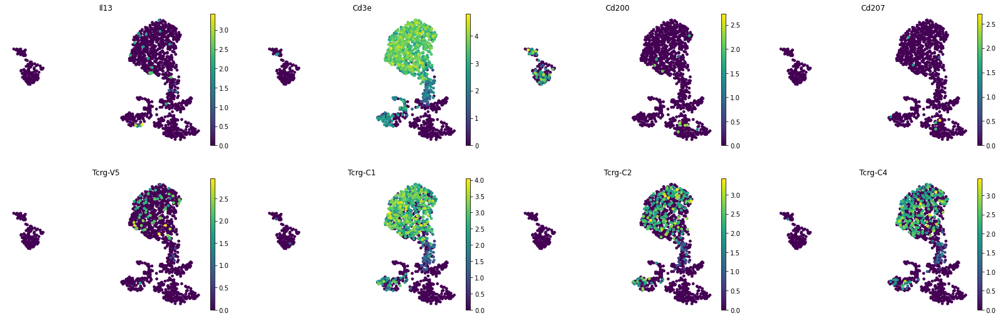

In [87]:
genes = ['Il13', 'Cd3e', 'Cd200', 'Cd207', 'Tcrg-V5', 'Tcrg-C1', 'Tcrg-C2', 'Tcrg-C4', 'Tcrg-V4', 'Tcrg-V6']
genes = [x for x in genes if x in adata.var_names]
sc.pl.umap(adata, color = genes, legend_loc='on data', frameon = False)

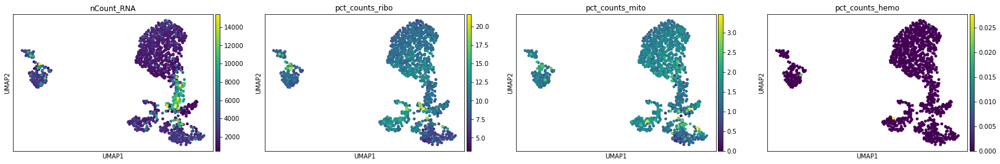

In [88]:
sc.pl.umap(adata, color = ['nCount_RNA', 'pct_counts_ribo','pct_counts_mito', 'pct_counts_hemo'])

## Save cells

In [89]:
path = '{}/My Drive/MKA/Papers/Greco/Sara and Nur/Loom files'.format(root)
filename = f'{sample}_validation_NonKC_RAW.loom'
adata.X = adata.raw[:, adata.var_names].X

In [90]:
adata.write_loom(os.path.join(path, filename), write_obsm_varm=True)

# WTMW

In [3]:
sample = 'WTMW'

In [27]:
path = '{}/My Drive/MKA/Papers/Greco/Sara and Nur/Loom files'.format(root)
filename = f'{sample}_validation.loom'

In [29]:
adata = sc.read_loom(os.path.join(path, filename), spec_version = 'old', validate = False)

In [30]:
raw_data = adata.copy()

In [31]:
adata.obs['seurat_clusters'] = adata.obs['seurat_clusters'].astype(str)
adata.var['ribo'] = adata.var_names.str.startswith('Rps') | adata.var_names.str.startswith('Rpl')
adata.var['mito'] = adata.var_names.str.startswith('mt')
adata.var['hemo'] = adata.var_names.str.startswith('Hba') | adata.var_names.str.startswith('Hbb')

In [32]:
adata

AnnData object with n_obs × n_vars = 26248 × 18970
    obs: 'Immune21', 'Infundibulum1', 'RBC1', 'RNA_snn_res.0.1', 'integrated_snn_res.0.1', 'nCount_RNA', 'nFeature_RNA', 'orig.ident', 'percent.mt', 'seurat_clusters'
    var: 'ribo', 'mito', 'hemo'
    layers: 'counts'

In [33]:
sc.pp.calculate_qc_metrics(adata, inplace = True, qc_vars = ['ribo','mito','hemo'])

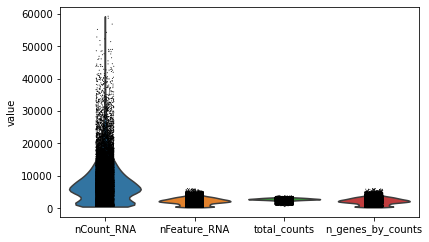

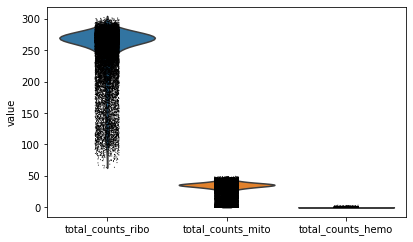

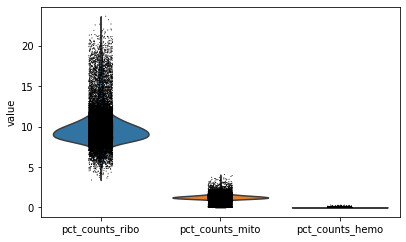

In [34]:
sc.pl.violin(adata, keys = ['nCount_RNA','nFeature_RNA', 'total_counts', 'n_genes_by_counts'])
sc.pl.violin(adata, keys = ['total_counts_ribo','total_counts_mito', 'total_counts_hemo'])
sc.pl.violin(adata, keys = ['pct_counts_ribo','pct_counts_mito', 'pct_counts_hemo'])

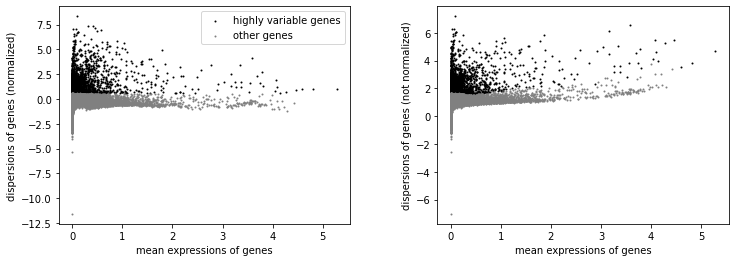

In [35]:
sc.pp.highly_variable_genes(adata, n_top_genes = 4000)
sc.pl.highly_variable_genes(adata)

In [36]:
adata.raw = adata

In [37]:
sc.pp.filter_genes(adata, min_cells=5)
sc.pp.filter_genes(adata, min_counts=10)

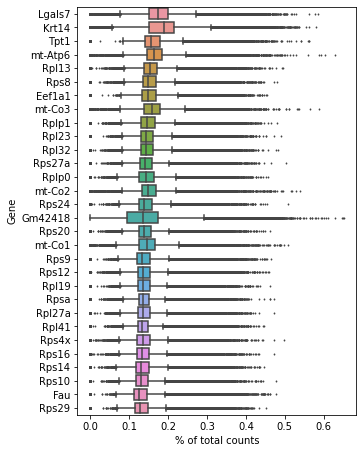

In [38]:
sc.pl.highest_expr_genes(adata)

In [39]:
sc.pp.scale(adata)

In [40]:
sc.pp.pca(adata)
sce.pp.harmony_integrate(adata, key = 'orig.ident')
#sc.pp.neighbors(adata, use_rep='X_pca_harmony')
bbknn.bbknn(adata, batch_key='orig.ident', use_rep='X_pca_harmony')
sc.tl.umap(adata, spread = 1)

2022-05-27 03:31:16,470 - harmonypy - INFO - Iteration 1 of 10
2022-05-27 03:31:51,235 - harmonypy - INFO - Iteration 2 of 10
2022-05-27 03:32:13,552 - harmonypy - INFO - Iteration 3 of 10
2022-05-27 03:32:34,852 - harmonypy - INFO - Iteration 4 of 10
2022-05-27 03:32:56,717 - harmonypy - INFO - Iteration 5 of 10
2022-05-27 03:33:18,451 - harmonypy - INFO - Iteration 6 of 10
2022-05-27 03:33:39,713 - harmonypy - INFO - Iteration 7 of 10
2022-05-27 03:34:01,743 - harmonypy - INFO - Converged after 7 iterations


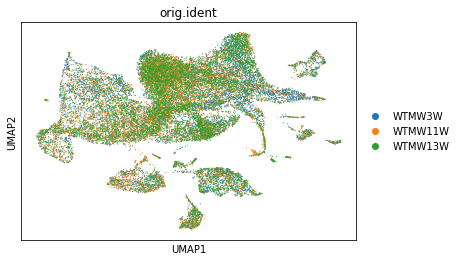

In [41]:
sc.pl.umap(adata, color = 'orig.ident')

In [42]:
sc.tl.leiden(adata, resolution = 0.3)

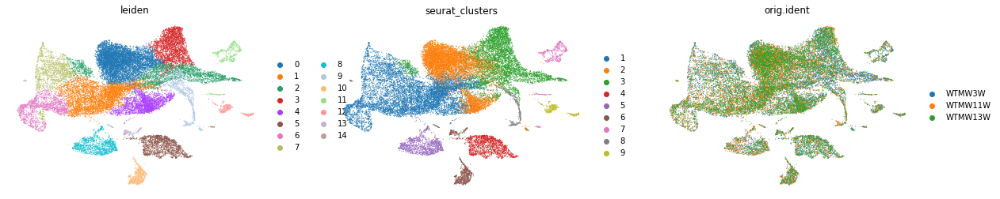

In [43]:
sc.pl.umap(adata, color = ['leiden', 'seurat_clusters', 'orig.ident'], frameon = False)

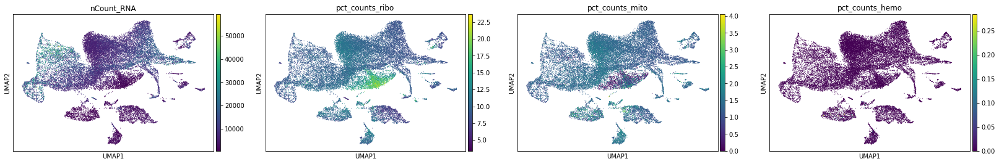

In [44]:
sc.pl.umap(adata, color = ['nCount_RNA', 'pct_counts_ribo','pct_counts_mito', 'pct_counts_hemo'])

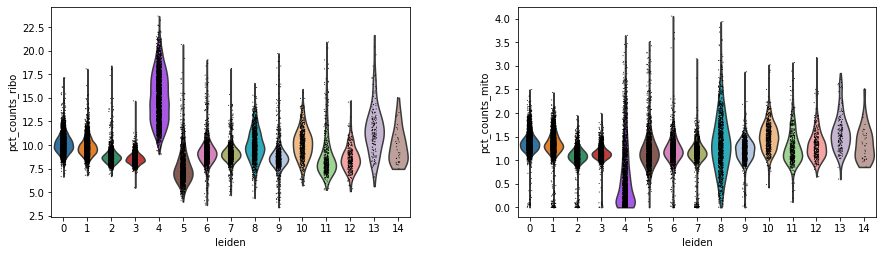

In [45]:
sc.pl.violin(adata, keys = ['pct_counts_ribo', 'pct_counts_mito'], groupby='leiden')

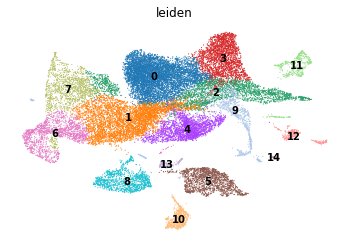

In [46]:
#sc.tl.leiden(adata, resolution = 0.5)
#sc.pl.umap(adata, color = ['leiden'])
sc.pl.umap(adata, color = ['leiden'], legend_loc='on data', frameon = False)

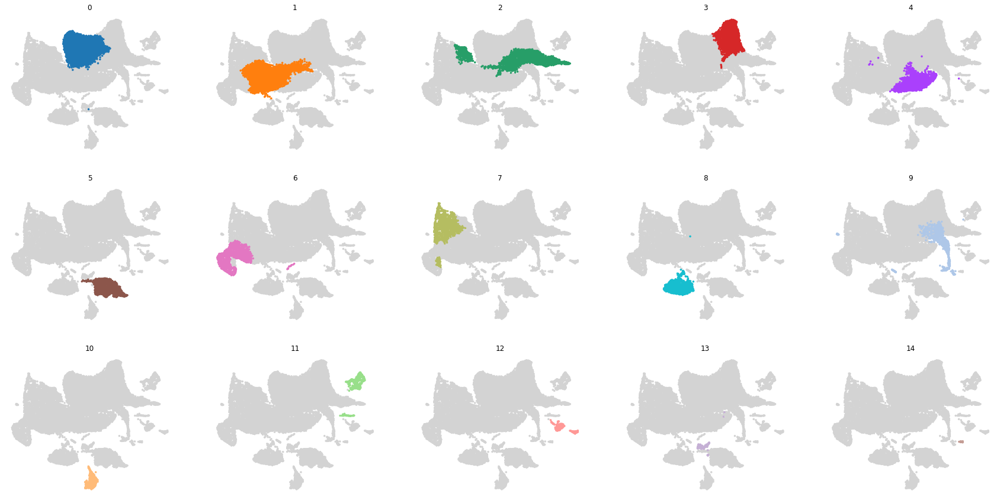

In [47]:
groups = adata.obs['leiden'].unique()
ncols = 5
fig, axes = initialize_subplots(len(groups), ncols = ncols, figsize_multiplier=(6,5))

for ix, g in enumerate(sorted(groups, key = lambda x: int(x))):
    ax = get_ax(axes, ix, ncols)
    sc.pl.umap(adata, color = 'leiden', ax = ax, show = False, frameon = False, groups = [g], legend_loc = 'on_data', title = g, s = 50)
clear_output()

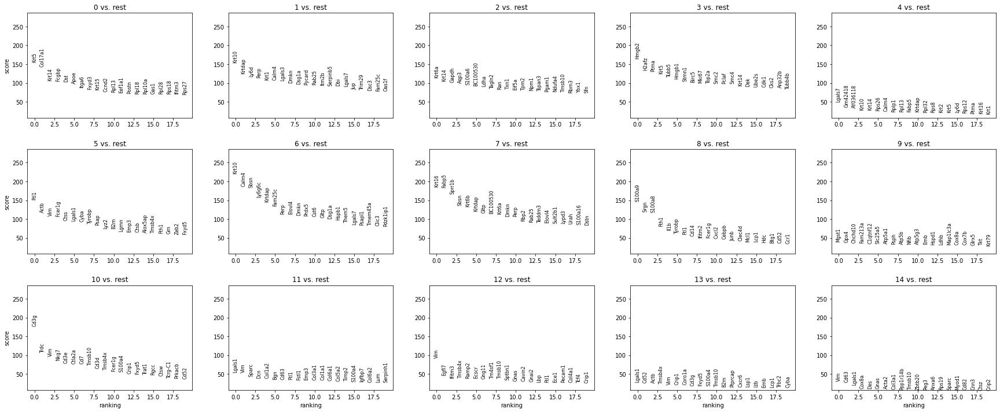

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
0,Krt5,Krt10,Krt6a,Hmgb2,Lgals7,Ftl1,Krt10,Krt16,S100a9,Mgst1,Cd3g,Lgals1,Vim,Lgals1,Vim
1,Col17a1,Krtdap,Krt14,H2afz,Gm42418,Actb,Calm4,Fabp5,Srgn,Gpx4,Trdc,Vim,Egfl7,Cd52,Cd63
2,Krt14,Ly6d,Gapdh,Ptma,AY036118,Vim,Sbsn,Sprr1b,S100a8,Chchd10,Vim,Sparc,Ifitm3,Actb,Lgals1
3,Fcgbp,Perp,Aqp3,Krt5,Krt10,Fcer1g,Ly6g6c,Sbsn,Fth1,Fam213a,Nkg7,Dcn,Tmsb4x,Tmsb4x,Cox8a
4,Dst,Krt1,S100a6,Tubb5,Krt14,Ctss,Krtdap,Krt6b,Il1b,C1qtnf12,Cd3e,Col1a2,Ramp2,Vim,Des
5,Apoe,Calm4,BC100530,Hmgb1,Rps26,Lgals1,Fam25c,Krtdap,Tyrobp,Slc25a5,Ctla2a,Bgn,Ecscr,Crip1,Gnas
6,Itga6,Lgals3,Ldha,Stmn1,Calm4,Cyba,Perp,Gltp,Ftl1,Atp5a1,Cd7,Cd63,Gng11,Coro1a,Acta2
7,Fxyd3,Dmkn,Tagln2,Birc5,Rplp1,Tyrobp,Elovl4,BC100530,Cd14,Psph,Tmsb10,Ftl1,Tm4sf1,Cd3g,Col3a1
8,Krt15,Dsg1a,Ran,Mki67,Rpl13,Psap,Dmkn,Krt6a,Ifitm2,Atp5b,Cd3d,Fstl1,Tmsb10,Fxyd5,Ppp1r14b
9,Ccnd2,Pycard,Txn1,Top2a,Fabp5,Lyz2,Prdx5,Dmkn,Fcer1g,Nfib,Tmsb4x,Emp3,Sptbn1,S100a4,Tmsb10


In [48]:
sc.tl.rank_genes_groups(adata, groupby = 'leiden')
sc.pl.rank_genes_groups(adata, ncols = 5)
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(20)

/home/karlan/miniconda3/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1227: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


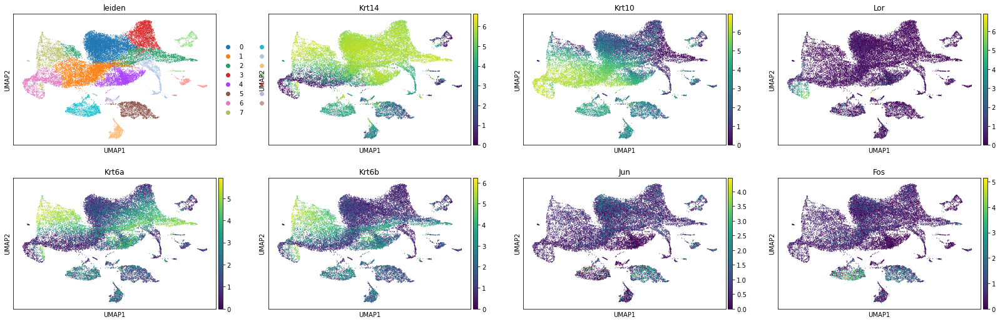

In [49]:
sc.pl.umap(adata, color = ['leiden', 'Krt14','Krt10','Lor', 'Krt6a','Krt6b','Jun','Fos'], groups = groups, ncols = 4)

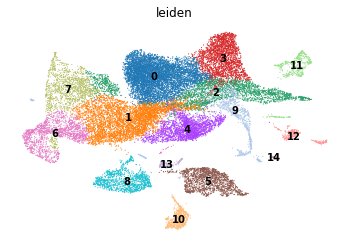

In [50]:
sc.pl.umap(adata, color = ['leiden'], legend_loc='on data', frameon = False)

## Remove KCs

In [51]:
KC_groups = ['0','1','2','3','4','6', '7', '9']

In [52]:
adata = adata[~adata.obs['leiden'].isin(KC_groups)].copy()

In [53]:
sc.pp.pca(adata)
sce.pp.harmony_integrate(adata, key = 'orig.ident')
#sc.pp.neighbors(adata, use_rep='X_pca_harmony')
#sc.pp.neighbors(adata)
bbknn.bbknn(adata, batch_key='orig.ident', use_rep='X_pca_harmony')
sc.tl.umap(adata, spread = 1)

2022-05-27 03:37:22,099 - harmonypy - INFO - Iteration 1 of 10
2022-05-27 03:37:31,062 - harmonypy - INFO - Iteration 2 of 10
2022-05-27 03:37:33,585 - harmonypy - INFO - Iteration 3 of 10
2022-05-27 03:37:35,272 - harmonypy - INFO - Iteration 4 of 10
2022-05-27 03:37:43,219 - harmonypy - INFO - Iteration 5 of 10
2022-05-27 03:37:53,633 - harmonypy - INFO - Iteration 6 of 10
2022-05-27 03:37:54,566 - harmonypy - INFO - Converged after 6 iterations


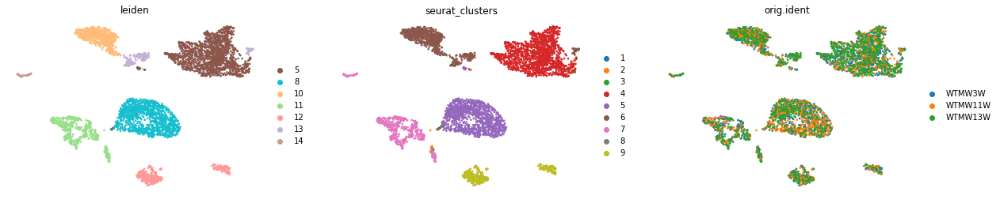

In [54]:
sc.pl.umap(adata, color = ['leiden', 'seurat_clusters', 'orig.ident'], frameon = False)

In [55]:
sc.tl.leiden(adata, resolution = 0.5)

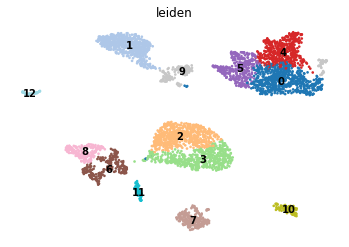

In [56]:
sc.pl.umap(adata, color = ['leiden'], legend_loc='on data', frameon = False, palette = 'tab20')

In [57]:
sc.tl.rank_genes_groups(adata, groupby = 'leiden')
sc.pl.rank_genes_groups(adata, ncols = 5)
clear_output()
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(20)


,0,1,2,3,4,5,6,7,8,9,10,11,12
0,Psap,Cd3g,S100a9,S100a9,Lgmn,Ifitm3,Sparc,Cldn5,Dcn,Rps24,Sparc,Dct,Rps8
1,Ctsl,Trdc,S100a8,S100a8,Ctsb,Lyz2,Dcn,Mmrn1,Col3a1,Eef1a1,Egfl7,Tyrp1,Cd63
2,Ctss,Nkg7,Srgn,Cxcl2,Pf4,Ctss,Col1a2,Egfl7,Col1a2,mt-Co3,Igfbp7,mt-Nd1,Rpl7
3,Ctsb,Cd3e,Il1b,Srgn,Grn,Ftl1,Bgn,Gng11,Sparc,Rplp0,Plvap,mt-Atp6,Rpl28
4,Lgals3,Cd7,Tyrobp,Cd14,Ctss,Tyrobp,Col6a1,Ecscr,Fstl1,Rpl32,Ifitm3,mt-Co3,Rps16
5,Plin2,Ctla2a,Hp,Il1b,Psap,Cyba,Col3a1,mt-Cytb,Col1a1,Rps13,Pecam1,mt-Cytb,Rpl9
6,Cstb,Cd3d,Ifitm2,Fth1,Ftl1,Fcer1g,Col1a1,Gnas,Fbn1,mt-Atp6,Vim,Pmel,Rps4x
7,Pf4,Tmsb10,Lrg1,Lgals7,Lgals1,Actb,Fstl1,Fgl2,Col5a2,Rps10,Fabp4,Cd63,Rpl13
8,Ftl1,Trat1,S100a11,Cebpb,Lyz2,Tgfbi,Rpsa,Ifitm3,Bgn,Rps4x,Eng,Ptgds,Rpl6
9,Grn,Ctsw,Lgals7,Krt14,Ms4a7,Fcgr1,Col5a2,Sptbn1,Lum,Rps16,Ramp2,mt-Co2,Rps19


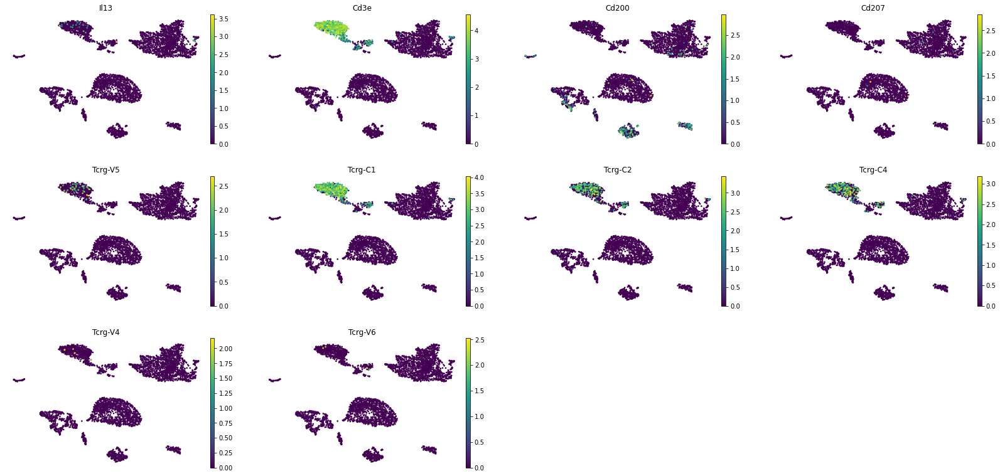

In [58]:
genes = ['Il13', 'Cd3e', 'Cd200', 'Cd207', 'Tcrg-V5', 'Tcrg-C1', 'Tcrg-C2', 'Tcrg-C4', 'Tcrg-V4', 'Tcrg-V6']
genes = [x for x in genes if x in adata.var_names]
sc.pl.umap(adata, color = genes, legend_loc='on data', frameon = False)

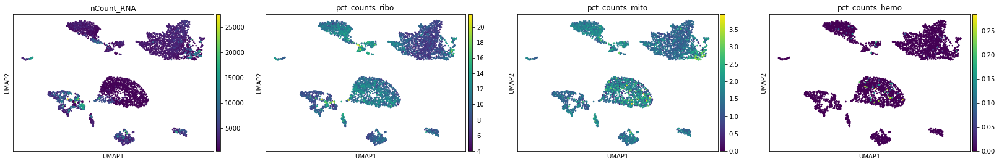

In [59]:
sc.pl.umap(adata, color = ['nCount_RNA', 'pct_counts_ribo','pct_counts_mito', 'pct_counts_hemo'])

## Save cells

In [60]:
path = '{}/My Drive/MKA/Papers/Greco/Sara and Nur/Loom files'.format(root)
filename = f'{sample}_validation_NonKC_RAW.loom'
adata.X = adata.raw[:, adata.var_names].X

In [61]:
adata.write_loom(os.path.join(path, filename), write_obsm_varm=True)

# WTFU

In [62]:
sample = 'WTFU'

In [63]:
path = '{}/My Drive/MKA/Papers/Greco/Sara and Nur/Loom files'.format(root)
filename = f'{sample}_validation.loom'

In [64]:
adata = sc.read_loom(os.path.join(path, filename), spec_version = 'old', validate = False)

In [65]:
raw_data = adata.copy()

In [66]:
adata.obs['seurat_clusters'] = adata.obs['seurat_clusters'].astype(str)
adata.var['ribo'] = adata.var_names.str.startswith('Rps') | adata.var_names.str.startswith('Rpl')
adata.var['mito'] = adata.var_names.str.startswith('mt')
adata.var['hemo'] = adata.var_names.str.startswith('Hba') | adata.var_names.str.startswith('Hbb')

In [67]:
adata

AnnData object with n_obs × n_vars = 31513 × 19024
    obs: 'Immune21', 'Infundibulum1', 'RBC1', 'RNA_snn_res.0.1', 'integrated_snn_res.0.1', 'nCount_RNA', 'nFeature_RNA', 'orig.ident', 'percent.mt', 'seurat_clusters'
    var: 'ribo', 'mito', 'hemo'
    layers: 'counts'

In [68]:
sc.pp.calculate_qc_metrics(adata, inplace = True, qc_vars = ['ribo','mito','hemo'])

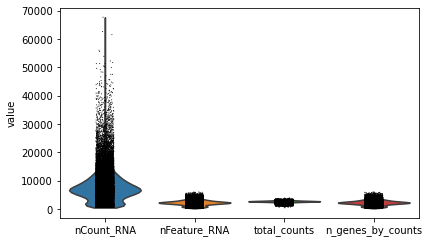

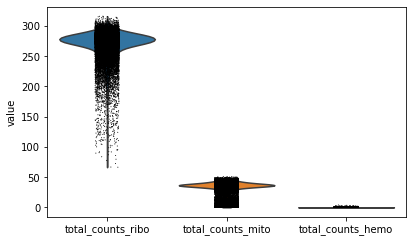

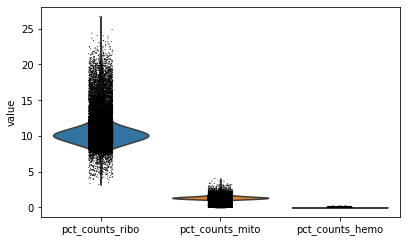

In [69]:
sc.pl.violin(adata, keys = ['nCount_RNA','nFeature_RNA', 'total_counts', 'n_genes_by_counts'])
sc.pl.violin(adata, keys = ['total_counts_ribo','total_counts_mito', 'total_counts_hemo'])
sc.pl.violin(adata, keys = ['pct_counts_ribo','pct_counts_mito', 'pct_counts_hemo'])

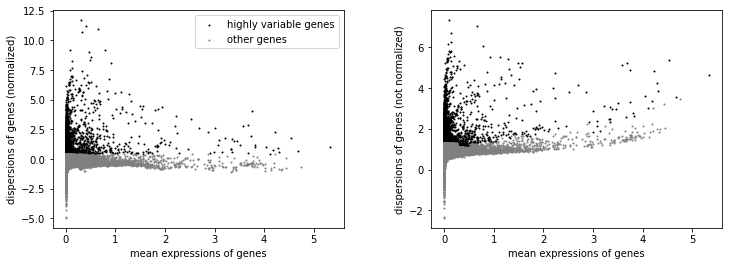

In [70]:
sc.pp.highly_variable_genes(adata, n_top_genes = 4000)
sc.pl.highly_variable_genes(adata)

In [71]:
adata.raw = adata

In [72]:
sc.pp.filter_genes(adata, min_cells=5)
sc.pp.filter_genes(adata, min_counts=10)

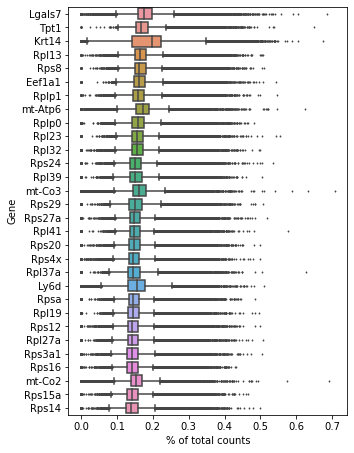

In [73]:
sc.pl.highest_expr_genes(adata)

In [74]:
sc.pp.scale(adata)

In [75]:
sc.pp.pca(adata)
sce.pp.harmony_integrate(adata, key = 'orig.ident')
#sc.pp.neighbors(adata, use_rep='X_pca_harmony')
bbknn.bbknn(adata, batch_key='orig.ident', use_rep='X_pca_harmony')
sc.tl.umap(adata, spread = 1)

2022-05-27 03:54:14,615 - harmonypy - INFO - Iteration 1 of 10
2022-05-27 03:54:52,219 - harmonypy - INFO - Iteration 2 of 10
2022-05-27 03:55:17,645 - harmonypy - INFO - Iteration 3 of 10
2022-05-27 03:57:12,831 - harmonypy - INFO - Iteration 4 of 10
2022-05-27 03:59:19,638 - harmonypy - INFO - Iteration 5 of 10
2022-05-27 04:01:32,548 - harmonypy - INFO - Iteration 6 of 10
2022-05-27 04:03:41,971 - harmonypy - INFO - Converged after 6 iterations


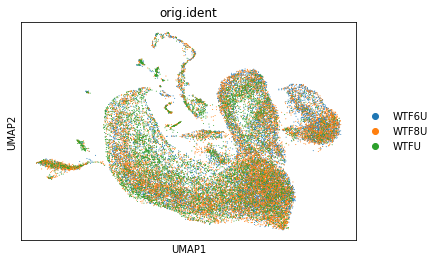

In [76]:
sc.pl.umap(adata, color = 'orig.ident')

In [77]:
sc.tl.leiden(adata, resolution = 0.3)

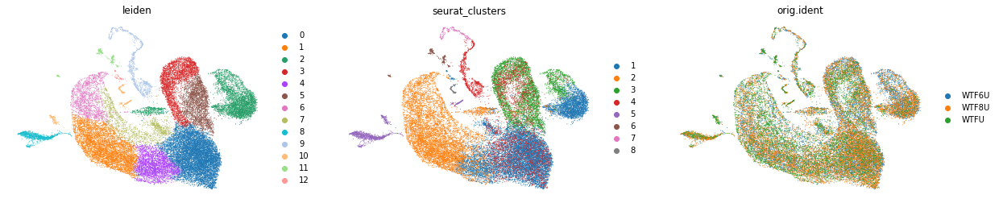

In [78]:
sc.pl.umap(adata, color = ['leiden', 'seurat_clusters', 'orig.ident'], frameon = False)

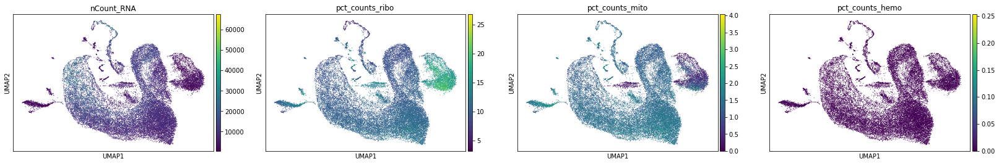

In [79]:
sc.pl.umap(adata, color = ['nCount_RNA', 'pct_counts_ribo','pct_counts_mito', 'pct_counts_hemo'])

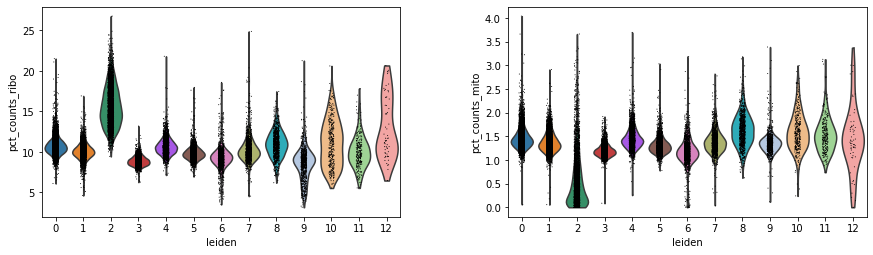

In [80]:
sc.pl.violin(adata, keys = ['pct_counts_ribo', 'pct_counts_mito'], groupby='leiden')

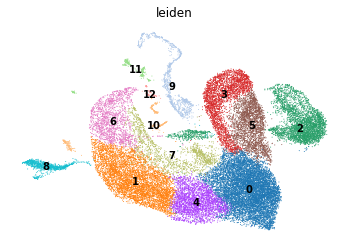

In [81]:
#sc.tl.leiden(adata, resolution = 0.5)
#sc.pl.umap(adata, color = ['leiden'])
sc.pl.umap(adata, color = ['leiden'], legend_loc='on data', frameon = False)

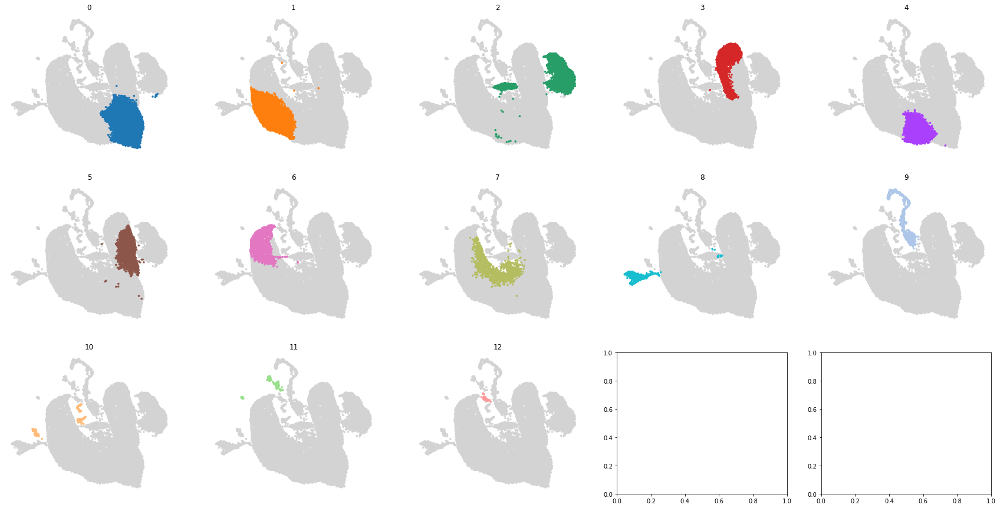

In [82]:
groups = adata.obs['leiden'].unique()
ncols = 5
fig, axes = initialize_subplots(len(groups), ncols = ncols, figsize_multiplier=(6,5))

for ix, g in enumerate(sorted(groups, key = lambda x: int(x))):
    ax = get_ax(axes, ix, ncols)
    sc.pl.umap(adata, color = 'leiden', ax = ax, show = False, frameon = False, groups = [g], legend_loc = 'on_data', title = g, s = 50)
clear_output()

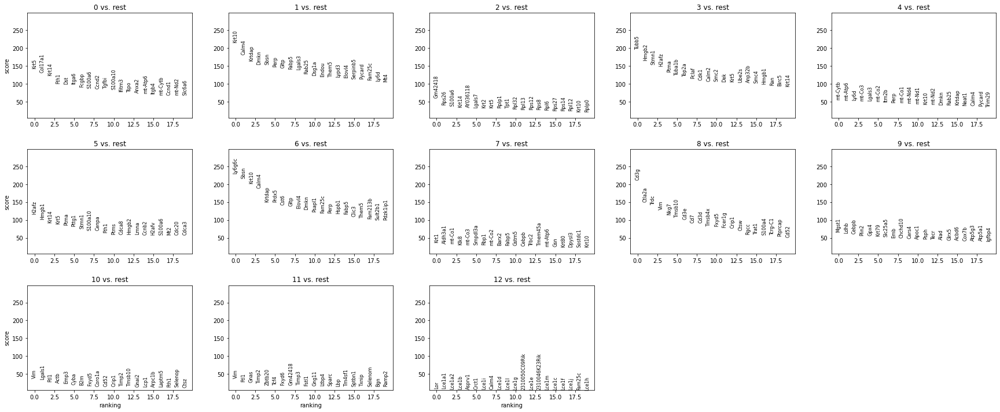

,0,1,2,3,4,5,6,7,8,9,10,11,12
0,Krt5,Krt10,Gm42418,Tubb5,mt-Cytb,H2afz,Ly6g6c,Krt1,Cd3g,Mgst1,Vim,Vim,Lor
1,Col17a1,Calm4,Rps26,Hmgb2,mt-Atp6,Hmgb1,Sbsn,Aldh3a1,Ctla2a,Ldhb,Lgals1,Ftl1,Lce1a1
2,Krt14,Krtdap,S100a6,Stmn1,Ly6d,Krt14,Krt10,mt-Co1,Trdc,Cebpb,Ftl1,Gnas,Lce1a2
3,Fth1,Dmkn,Krt14,H2afz,mt-Co3,Krt5,Calm4,Klk8,Vim,Plin2,Actb,Timp2,Lce1b
4,Dst,Sbsn,AY036118,Ptma,Lgals3,Ptma,Krtdap,mt-Co3,Nkg7,Gpx4,Emp3,Zbtb20,Asprv1
5,Itga6,Perp,Lgals7,Tuba1b,mt-Co2,Pttg1,Prdx5,Smpdl3a,Tmsb10,Krt79,Cyba,Tcf4,Crct1
6,Fcgbp,Gltp,Krt2,Top2a,Itm2b,Stmn1,Cst6,Rbp1,Cd3e,Slc25a5,B2m,Fxyd6,Lce1i
7,S100a6,Fabp5,Krt5,Pclaf,Perp,S100a10,Gltp,mt-Co2,Cd7,Emb,Fxyd5,Gm42418,Calm4
8,Ccnd2,Lgals3,Rplp1,Cdk1,mt-Co1,Cenpa,Elovl4,Barx2,Cd3d,Chchd10,Coro1a,Timp3,Lce1d
9,Tgfbi,Rab25,Tpt1,Calm2,mt-Nd4,Fth1,Dmkn,Fabp5,Tmsb4x,Cers4,Cd52,Fstl1,Lce1l


In [83]:
sc.tl.rank_genes_groups(adata, groupby = 'leiden')
sc.pl.rank_genes_groups(adata, ncols = 5)
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(20)

/home/karlan/miniconda3/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1227: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


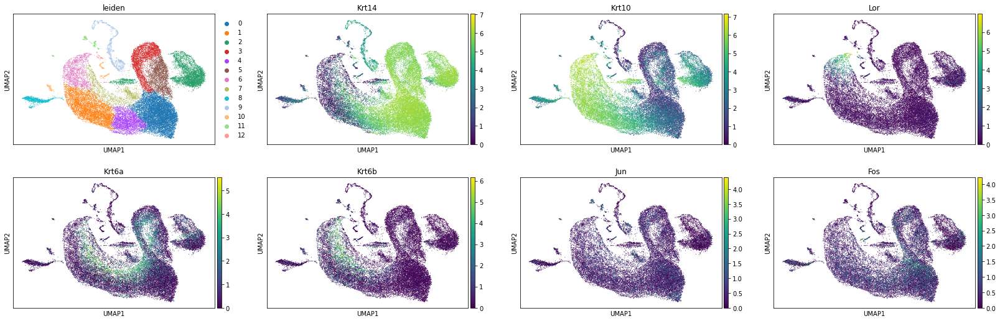

In [84]:
sc.pl.umap(adata, color = ['leiden', 'Krt14','Krt10','Lor', 'Krt6a','Krt6b','Jun','Fos'], groups = groups, ncols = 4)

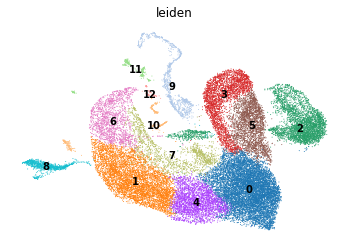

In [85]:
sc.pl.umap(adata, color = ['leiden'], legend_loc='on data', frameon = False)

## Remove KCs

In [86]:
KC_groups = ['0','1','2','3','4','6', '7', '9', '12']

In [87]:
adata = adata[~adata.obs['leiden'].isin(KC_groups)].copy()

In [88]:
sc.pp.pca(adata)
sce.pp.harmony_integrate(adata, key = 'orig.ident')
#sc.pp.neighbors(adata, use_rep='X_pca_harmony')
#sc.pp.neighbors(adata)
bbknn.bbknn(adata, batch_key='orig.ident', use_rep='X_pca_harmony')
sc.tl.umap(adata, spread = 1)

2022-05-27 04:05:42,851 - harmonypy - INFO - Iteration 1 of 10
2022-05-27 04:06:00,502 - harmonypy - INFO - Iteration 2 of 10
2022-05-27 04:06:03,035 - harmonypy - INFO - Iteration 3 of 10
2022-05-27 04:06:04,854 - harmonypy - INFO - Converged after 3 iterations


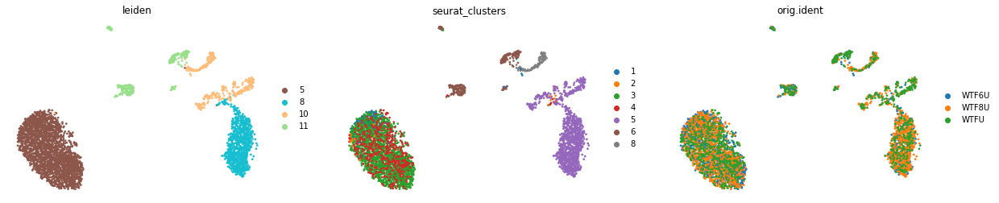

In [89]:
sc.pl.umap(adata, color = ['leiden', 'seurat_clusters', 'orig.ident'], frameon = False)

In [90]:
sc.tl.leiden(adata, resolution = 0.5)

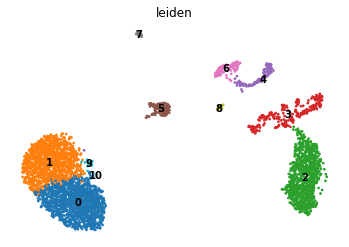

In [91]:
sc.pl.umap(adata, color = ['leiden'], legend_loc='on data', frameon = False, palette = 'tab20')

In [92]:
sc.tl.rank_genes_groups(adata, groupby = 'leiden')
sc.pl.rank_genes_groups(adata, ncols = 5)
clear_output()
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(20)


,0,1,2,3,4,5,6,7,8,9,10
0,Cdc20,Krt14,Cd3g,Lgals1,Dct,Vim,Col1a2,Fabp4,Itm2a,Fxyd3,Atp1a1
1,Tubb4b,Krt5,Trdc,Tmsb4x,Ftl1,Cldn5,Sparc,Plvap,Acta2,Krt14,Krt5
2,Hmgb2,Fxyd3,Ctla2a,Cyba,Pmel,Egfl7,Bgn,Ifitm3,Lgals1,Lgals7,Srsf6
3,Krt5,Perp,Nkg7,Fabp5,Cd63,Gng11,Col3a1,Sparc,Rpl26,Perp,Srebf2
4,Krt14,Lgals7,Cd3e,Coro1a,Ptgds,Fxyd6,Dcn,Ehd4,Tpt1,Krt5,Ckap2l
5,Cenpa,S100a14,Cd7,Cd52,Tyrp1,Fgl2,Col6a1,Lrg1,Gnas,Eif4a3,Krt14
6,Cks2,tdTomato,Cd3d,Vim,Mgll,Ccl21a,Col6a2,Ifitm2,Spats2l,Rpl7a,Yeats4
7,Birc5,GFP,Vim,Actb,Gpnmb,Mmrn1,Col1a1,Egfl7,Meg3,Itga6,Hadha
8,Fxyd3,Sfn,Tmsb10,B2m,Mt1,Tm4sf1,Col5a2,Ly6e,Dag1,Rpl10a,Ptma
9,Ccnb2,Hmgn1,Fcer1g,Fxyd5,Mlana,Timp3,Mgp,Vim,Sparc,Txndc17,Rin2


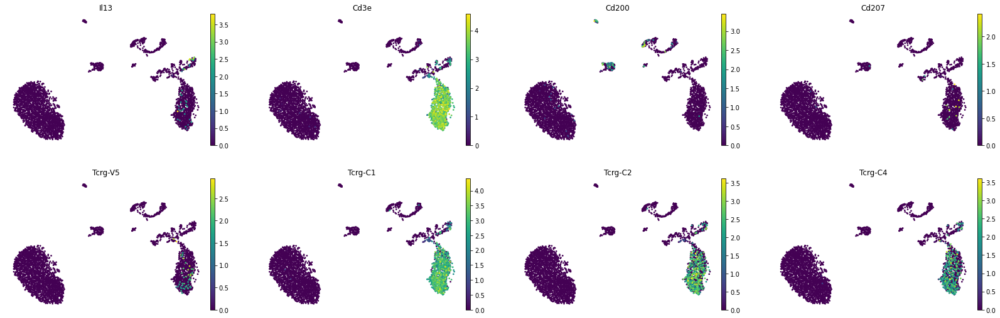

In [93]:
genes = ['Il13', 'Cd3e', 'Cd200', 'Cd207', 'Tcrg-V5', 'Tcrg-C1', 'Tcrg-C2', 'Tcrg-C4', 'Tcrg-V4', 'Tcrg-V6']
genes = [x for x in genes if x in adata.var_names]
sc.pl.umap(adata, color = genes, legend_loc='on data', frameon = False)

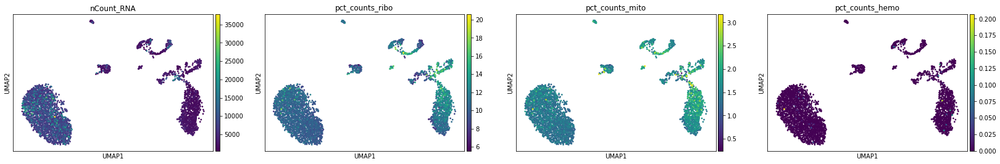

In [94]:
sc.pl.umap(adata, color = ['nCount_RNA', 'pct_counts_ribo','pct_counts_mito', 'pct_counts_hemo'])

## Save cells

In [95]:
path = '{}/My Drive/MKA/Papers/Greco/Sara and Nur/Loom files'.format(root)
filename = f'{sample}_validation_NonKC_RAW.loom'
adata.X = adata.raw[:, adata.var_names].X

In [96]:
adata.write_loom(os.path.join(path, filename), write_obsm_varm=True)

# WTFW

In [3]:
sample = 'WTFW'

In [4]:
path = '{}/My Drive/MKA/Papers/Greco/Sara and Nur/Loom files'.format(root)
filename = f'{sample}_validation.loom'

In [5]:
adata = sc.read_loom(os.path.join(path, filename), spec_version = 'old', validate = False)

In [6]:
raw_data = adata.copy()

In [7]:
adata.obs['seurat_clusters'] = adata.obs['seurat_clusters'].astype(str)
adata.var['ribo'] = adata.var_names.str.startswith('Rps') | adata.var_names.str.startswith('Rpl')
adata.var['mito'] = adata.var_names.str.startswith('mt')
adata.var['hemo'] = adata.var_names.str.startswith('Hba') | adata.var_names.str.startswith('Hbb')

In [8]:
adata

AnnData object with n_obs × n_vars = 25373 × 19052
    obs: 'Immune21', 'Infundibulum1', 'RBC1', 'RNA_snn_res.0.1', 'integrated_snn_res.0.1', 'nCount_RNA', 'nFeature_RNA', 'orig.ident', 'percent.mt', 'seurat_clusters'
    var: 'ribo', 'mito', 'hemo'
    layers: 'counts'

In [9]:
sc.pp.calculate_qc_metrics(adata, inplace = True, qc_vars = ['ribo','mito','hemo'])

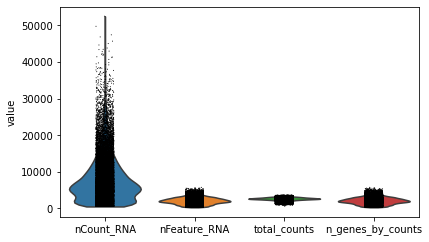

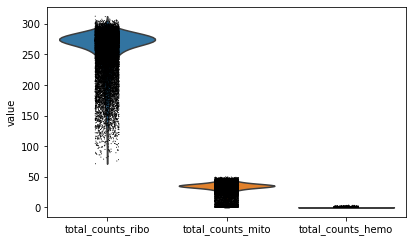

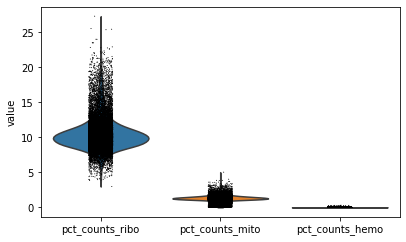

In [10]:
sc.pl.violin(adata, keys = ['nCount_RNA','nFeature_RNA', 'total_counts', 'n_genes_by_counts'])
sc.pl.violin(adata, keys = ['total_counts_ribo','total_counts_mito', 'total_counts_hemo'])
sc.pl.violin(adata, keys = ['pct_counts_ribo','pct_counts_mito', 'pct_counts_hemo'])

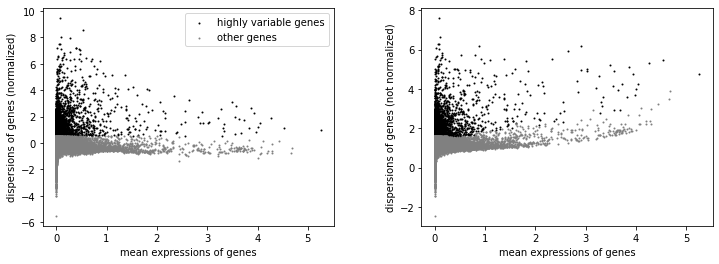

In [11]:
sc.pp.highly_variable_genes(adata, n_top_genes = 4000)
sc.pl.highly_variable_genes(adata)

In [12]:
adata.raw = adata

In [13]:
sc.pp.filter_genes(adata, min_cells=5)
sc.pp.filter_genes(adata, min_counts=10)

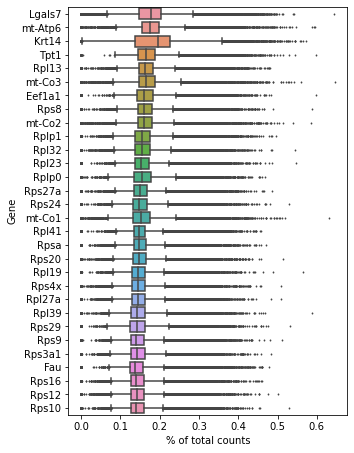

In [14]:
sc.pl.highest_expr_genes(adata)

In [15]:
sc.pp.scale(adata)

In [16]:
sc.pp.pca(adata)
sce.pp.harmony_integrate(adata, key = 'orig.ident')
#sc.pp.neighbors(adata, use_rep='X_pca_harmony')
bbknn.bbknn(adata, batch_key='orig.ident', use_rep='X_pca_harmony')
sc.tl.umap(adata, spread = 1)

2022-05-27 04:36:22,976 - harmonypy - INFO - Iteration 1 of 10
2022-05-27 04:37:04,019 - harmonypy - INFO - Iteration 2 of 10
2022-05-27 04:37:30,901 - harmonypy - INFO - Iteration 3 of 10
2022-05-27 04:37:56,562 - harmonypy - INFO - Iteration 4 of 10
2022-05-27 04:38:22,039 - harmonypy - INFO - Iteration 5 of 10
2022-05-27 04:38:47,925 - harmonypy - INFO - Iteration 6 of 10
2022-05-27 04:39:13,556 - harmonypy - INFO - Iteration 7 of 10
2022-05-27 04:39:39,024 - harmonypy - INFO - Converged after 7 iterations


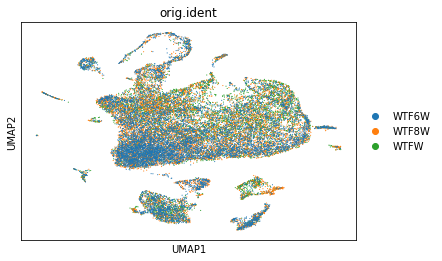

In [17]:
sc.pl.umap(adata, color = 'orig.ident')

In [18]:
sc.tl.leiden(adata, resolution = 0.3)

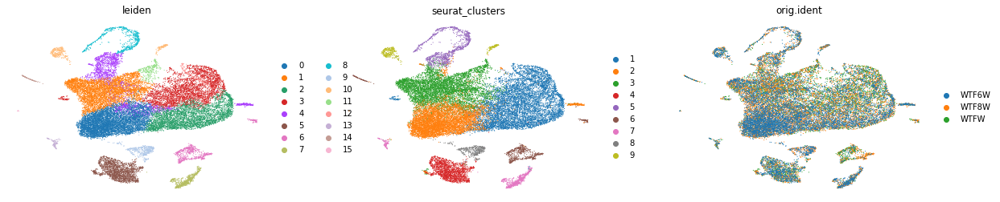

In [19]:
sc.pl.umap(adata, color = ['leiden', 'seurat_clusters', 'orig.ident'], frameon = False)

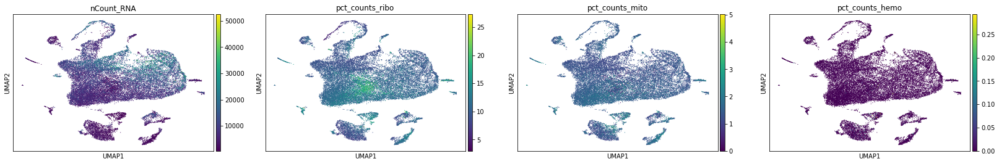

In [20]:
sc.pl.umap(adata, color = ['nCount_RNA', 'pct_counts_ribo','pct_counts_mito', 'pct_counts_hemo'])

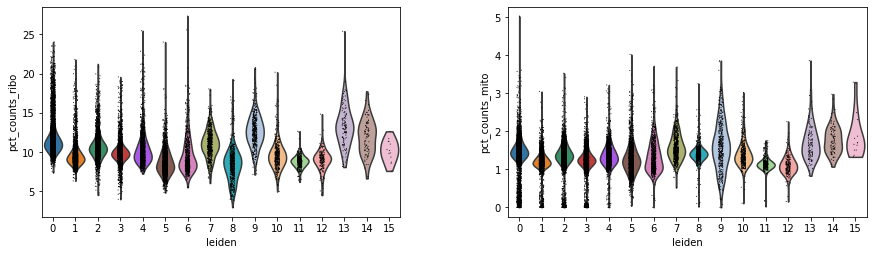

In [21]:
sc.pl.violin(adata, keys = ['pct_counts_ribo', 'pct_counts_mito'], groupby='leiden')

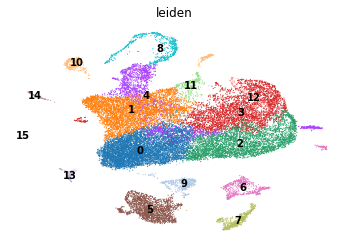

In [22]:
#sc.tl.leiden(adata, resolution = 0.5)
#sc.pl.umap(adata, color = ['leiden'])
sc.pl.umap(adata, color = ['leiden'], legend_loc='on data', frameon = False)

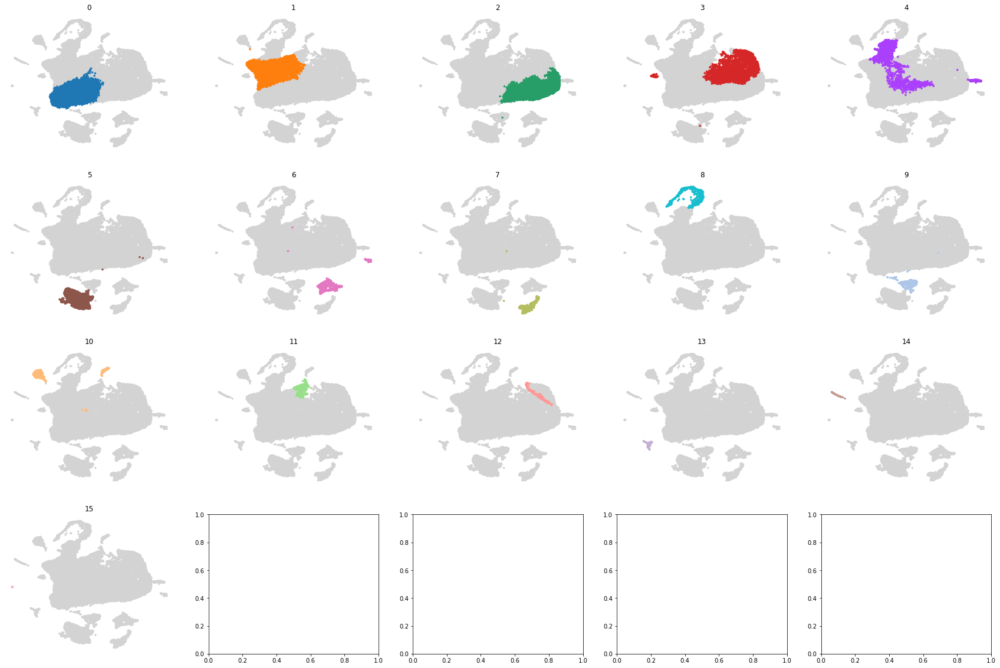

In [23]:
groups = adata.obs['leiden'].unique()
ncols = 5
fig, axes = initialize_subplots(len(groups), ncols = ncols, figsize_multiplier=(6,5))

for ix, g in enumerate(sorted(groups, key = lambda x: int(x))):
    ax = get_ax(axes, ix, ncols)
    sc.pl.umap(adata, color = 'leiden', ax = ax, show = False, frameon = False, groups = [g], legend_loc = 'on_data', title = g, s = 50)
clear_output()

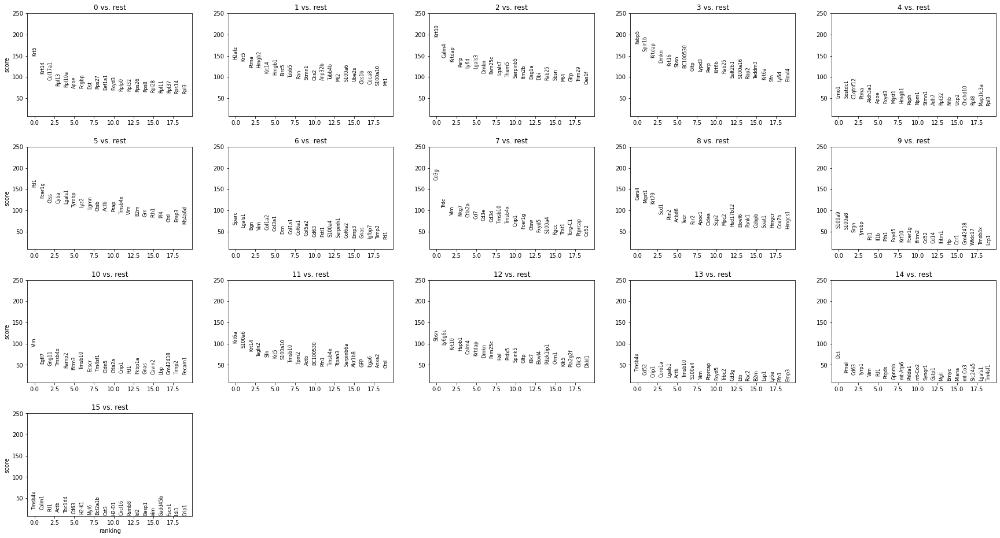

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
0,Krt5,H2afz,Krt10,Fabp5,Lmo1,Ftl1,Sparc,Cd3g,Cers4,S100a9,Vim,Krt6a,Sbsn,Tmsb4x,Dct,Tmsb4x
1,Krt14,Krt5,Calm4,Sprr1b,Sostdc1,Fcer1g,Lgals1,Trdc,Mgst1,S100a8,Egfl7,S100a6,Ly6g6c,Cd52,Pmel,Calm1
2,Col17a1,Ptma,Krtdap,Krtdap,C1qtnf12,Ctss,Bgn,Vim,Krt79,Srgn,Gng11,Krt14,Krt10,Crip1,Cd63,Ftl1
3,Rpl13,Hmgb2,Perp,Dmkn,Ptma,Cyba,Vim,Nkg7,Scd1,Tyrobp,Tmsb4x,Tagln2,Hspb1,Coro1a,Tyrp1,Actb
4,Rpl10a,Krt14,Ly6d,Krt16,Aldh3a1,Lgals1,Col1a2,Ctla2a,Plin2,Ftl1,Ramp2,Sfn,Calm4,Lgals1,Vim,Tbc1d4
5,Apoe,Hmgb1,Lgals3,Sbsn,Apoe,Tyrobp,Col3a1,Cd7,Acbd6,Il1b,Ifitm3,Krt5,Krtdap,Actb,Ftl1,Cd63
6,Fcgbp,Birc5,Dmkn,BC100530,Fxyd3,Lyz2,Dcn,Cd3e,Tecr,Fth1,Tmsb10,S100a10,Dmkn,Tmsb10,Ptgds,H2-K1
7,Dst,Tubb5,Fam25c,Gltp,Mgst1,Lgmn,Col1a1,Cd3d,Far2,Fxyd5,Ecscr,Tmsb10,Fam25c,S100a4,Gpnmb,Myl6
8,Rps27,Ran,Lgals7,Lypd3,Hmgb1,Ctsb,Col6a1,Tmsb10,Apoc1,Krt10,Tm4sf1,Tpm2,Hal,Vim,mt-Atp6,Bcl2a1b
9,Eef1a1,Stmn1,Them5,Perp,Psph,Actb,Col5a2,Tmsb4x,Cidea,Fcer1g,Cldn5,Actb,Prdx5,Ptprcap,Phlda1,Cst3


In [24]:
sc.tl.rank_genes_groups(adata, groupby = 'leiden')
sc.pl.rank_genes_groups(adata, ncols = 5)
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(20)

/home/karlan/miniconda3/envs/scanpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1227: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


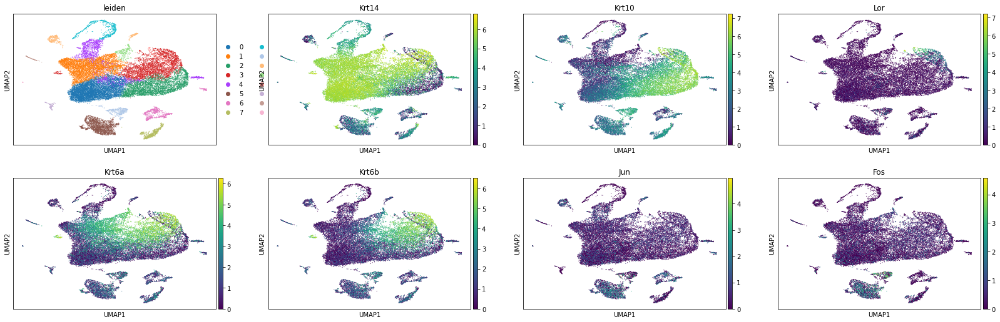

In [25]:
sc.pl.umap(adata, color = ['leiden', 'Krt14','Krt10','Lor', 'Krt6a','Krt6b','Jun','Fos'], groups = groups, ncols = 4)

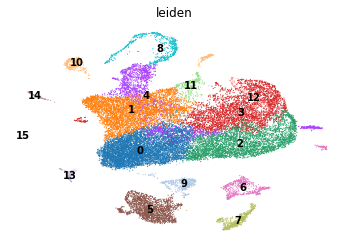

In [26]:
sc.pl.umap(adata, color = ['leiden'], legend_loc='on data', frameon = False)

## Remove KCs

In [27]:
KC_groups = ['0','1','2','3','4','8','9', '11', '12']

In [28]:
adata = adata[~adata.obs['leiden'].isin(KC_groups)].copy()

In [29]:
sc.pp.pca(adata)
sce.pp.harmony_integrate(adata, key = 'orig.ident')
#sc.pp.neighbors(adata, use_rep='X_pca_harmony')
#sc.pp.neighbors(adata)
bbknn.bbknn(adata, batch_key='orig.ident', use_rep='X_pca_harmony')
sc.tl.umap(adata, spread = 1)

2022-05-27 04:42:41,364 - harmonypy - INFO - Iteration 1 of 10
2022-05-27 04:42:50,782 - harmonypy - INFO - Iteration 2 of 10
2022-05-27 04:42:57,361 - harmonypy - INFO - Iteration 3 of 10
2022-05-27 04:42:58,927 - harmonypy - INFO - Iteration 4 of 10
2022-05-27 04:42:59,668 - harmonypy - INFO - Iteration 5 of 10
2022-05-27 04:43:00,316 - harmonypy - INFO - Iteration 6 of 10
2022-05-27 04:43:01,083 - harmonypy - INFO - Converged after 6 iterations


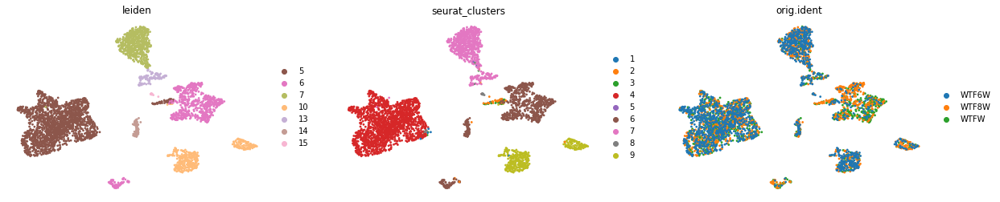

In [30]:
sc.pl.umap(adata, color = ['leiden', 'seurat_clusters', 'orig.ident'], frameon = False)

In [31]:
sc.tl.leiden(adata, resolution = 0.5)

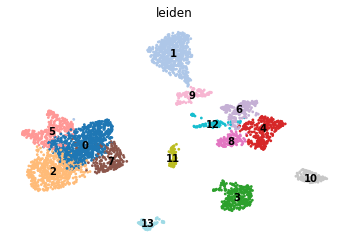

In [32]:
sc.pl.umap(adata, color = ['leiden'], legend_loc='on data', frameon = False, palette = 'tab20')

In [33]:
sc.tl.rank_genes_groups(adata, groupby = 'leiden')
sc.pl.rank_genes_groups(adata, ncols = 5)
clear_output()
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(20)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13
0,Ctsl,Cd3g,Lgmn,Cldn5,Sparc,Tyrobp,Sparc,Ctsb,Col3a1,Cd52,Fabp4,Dct,Lgals7,Hsp90ab1
1,Ftl1,Trdc,Lyz2,Egfl7,Bgn,Fcer1g,Col1a2,Lgals7,Dcn,Rplp1,Sparc,Pmel,Krt5,Ppp1r14b
2,Ctss,Nkg7,Ctsb,Gng11,Timp1,Ifitm3,Bgn,Lgmn,Col1a2,Rplp0,Egfl7,Tyrp1,Perp,Rpl14
3,Lgals3,Cd7,Pf4,Mmrn1,Dcn,Cyba,Col3a1,Krt14,Sparc,Coro1a,Plvap,Cd63,Krt14,Rack1
4,Fth1,Cd3e,Selenop,Cd9,Serpinh1,Cd52,Mgp,Fabp5,Fstl1,Rps3a1,Ramp2,Ptgds,Rps26,Rps5
5,Psap,Cd3d,Tyrobp,Ramp2,Aebp1,Lyz2,Col8a1,Calm4,Col1a1,Rpl12,Igfbp7,mt-Atp6,Rpl11,Gnas
6,Ctsb,Ctla2a,Ftl1,Fgl2,Col1a2,Ftl1,Abi3bp,Apoe,Lum,Rpsa,Ifitm3,Phlda1,Cd9,Rpl28
7,Cyba,Ctsw,Ctss,Crip2,Fstl1,Ms4a6c,Col1a1,Ly6d,Bgn,Tmsb4x,Crip2,mt-Co2,Fxyd3,Eef1b2
8,Pf4,Rgcc,Ms4a7,Ecscr,Fbln2,Ctss,Igfbp7,Krtdap,Col5a2,Trbc2,Ctla2a,Mgll,Sfn,Des
9,Cstb,Trat1,Grn,Lbp,Col1a1,Ms4a4c,Gsn,Psap,Col6a1,Ptprcap,Aqp1,Gpnmb,Rpl10a,Rps15


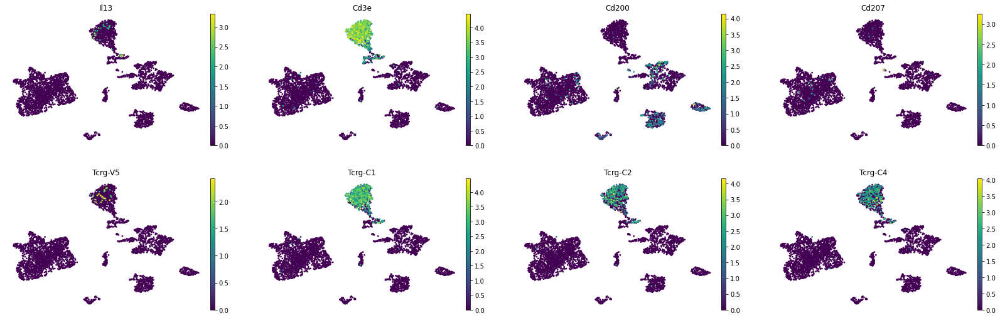

In [34]:
genes = ['Il13', 'Cd3e', 'Cd200', 'Cd207', 'Tcrg-V5', 'Tcrg-C1', 'Tcrg-C2', 'Tcrg-C4', 'Tcrg-V4', 'Tcrg-V6']
genes = [x for x in genes if x in adata.var_names]
sc.pl.umap(adata, color = genes, legend_loc='on data', frameon = False)

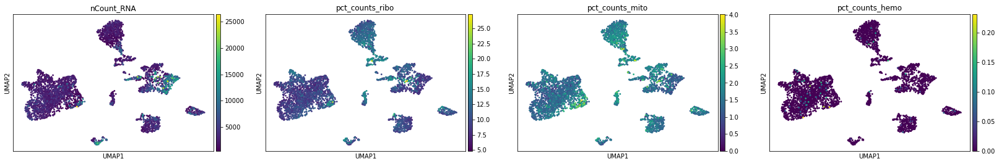

In [35]:
sc.pl.umap(adata, color = ['nCount_RNA', 'pct_counts_ribo','pct_counts_mito', 'pct_counts_hemo'])

## Save cells

In [36]:
path = '{}/My Drive/MKA/Papers/Greco/Sara and Nur/Loom files'.format(root)
filename = f'{sample}_validation_NonKC_RAW.loom'
adata.X = adata.raw[:, adata.var_names].X

In [37]:
adata.write_loom(os.path.join(path, filename), write_obsm_varm=True)